In [99]:
import os
import cv2
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import random
import torch
from cuml.manifold import TSNE
from torchvision import transforms
import albumentations as A
import numpy as np
from albumentations.pytorch import ToTensorV2
from tqdm import tqdm
import torch.nn as nn
from sklearn.model_selection import train_test_split
import seaborn as sns
from torch.utils.data import Subset
import edl_pytorch
from edl_pytorch import Dirichlet, evidential_classification
import kagglehub
import torch.nn.functional as F
import pandas as pd

In [2]:
# Download latest version
dataset_path = kagglehub.dataset_download("rahmasleam/flowers-dataset")

print("Path to dataset files:", dataset_path)

Path to dataset files: /usr/home/j/017/tur60842/.cache/kagglehub/datasets/rahmasleam/flowers-dataset/versions/1


In [3]:
class FlowersDataset(Dataset):
    def __init__(self, root_dir, mode='train', transform=None):
        """
        Args:
            root_dir (str): Root directory of the dataset.
            mode (str): 'train', 'val', or 'test'.
            transform (callable, optional): Transform to apply to images.
        """
        self.root_dir = os.path.join(root_dir, 'flower_photos')
        self.mode = mode
        self.transform = transform

        # Extract all class names (folder names)
        self.classes = [d for d in sorted(os.listdir(self.root_dir)) if os.path.isdir(os.path.join(self.root_dir, d))]
        self.class_to_idx = {cls_name: idx for idx, cls_name in enumerate(self.classes)}

        # Collect all image paths and labels
        self.data = []
        for cls_name in self.classes:
            cls_dir = os.path.join(self.root_dir, cls_name)
            for img_name in os.listdir(cls_dir):
                self.data.append((os.path.join(cls_dir, img_name), self.class_to_idx[cls_name]))

        # Stratified splitting
        self.train_data, self.val_data, self.test_data = self._stratified_split()

        # Select the correct data split based on mode
        if mode == 'train':
            self.data = self.train_data
        elif mode == 'val':
            self.data = self.val_data
        elif mode == 'test':
            self.data = self.test_data
        elif mode == 'full':
            self.data = self.data
        else:
            raise ValueError("Mode should be 'train', 'val', or 'test'")

    def _stratified_split(self):
        """Performs stratified splitting for train, val, and test sets."""
        # Extract file paths and labels
        file_paths = [item[0] for item in self.data]
        labels = [item[1] for item in self.data]

        # Split train and remaining (stratified)
        train_paths, temp_paths, train_labels, temp_labels = train_test_split(
            file_paths, labels, test_size=0.2, stratify=labels, random_state=42
        )

        # Split validation and test sets (stratified)
        val_paths, test_paths, val_labels, test_labels = train_test_split(
            temp_paths, temp_labels, test_size=0.5, stratify=temp_labels, random_state=42
        )

        # Combine paths and labels back into tuples
        train_data = list(zip(train_paths, train_labels))
        val_data = list(zip(val_paths, val_labels))
        test_data = list(zip(test_paths, test_labels))

        return train_data, val_data, test_data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path, label = self.data[idx]
        image = Image.open(img_path).convert("RGB")  # Ensure images are in RGB format
        image = np.asarray(image)

        if self.transform:
            image = self.transform(image=image)['image']

        return image, label

In [4]:
transforms = A.Compose([
                A.SmallestMaxSize(256),
                A.CenterCrop(224, 224),
                A.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225]),
                ToTensorV2()])

In [5]:
batch_size = 512

In [6]:
# Create dataset objects for train, val, and test
train_dataset = FlowersDataset(root_dir=dataset_path, mode='train', transform=transforms)
val_dataset = FlowersDataset(root_dir=dataset_path, mode='val', transform=transforms)
test_dataset = FlowersDataset(root_dir=dataset_path, mode='test', transform=transforms)
full_dataset = FlowersDataset(root_dir=dataset_path, mode='full', transform=transforms)

# DataLoader examples
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)
full_loader = DataLoader(full_dataset, batch_size=32, shuffle=False)

# Print dataset sizes
print(f"Train size: {len(train_dataset)}")
print(f"Validation size: {len(val_dataset)}")
print(f"Test size: {len(test_dataset)}")
print(f"Full size: {len(full_dataset)}")

Train size: 2936
Validation size: 367
Test size: 367
Full size: 3670


In [7]:
def visualize_random_images_per_class(dataset, rows=1):
    """
    Visualizes a random image from each class in the dataset, arranged in a tightly spaced grid.
    Args:
        dataset: The dataset object to visualize.
        rows (int): Number of rows in the visualization grid.
    """
    class_to_images = {class_name: [] for class_name in dataset.classes}

    # Collect image indices per class
    for idx, (_, label) in enumerate(dataset):
        class_to_images[dataset.classes[label]].append(idx)

    num_classes = len(dataset.classes)
    cols = (num_classes + rows - 1) // rows  # Calculate number of columns dynamically

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    axes = axes.flatten()  # Flatten the axes for easy indexing

    for i, class_name in enumerate(dataset.classes):
        random_idx = random.choice(class_to_images[class_name])
        image, _ = dataset[random_idx]

        # Convert image tensor to numpy array for visualization
        image_np = image.permute(1, 2, 0).numpy()

        # Ensure the image is in the range [0, 1] for visualization
        image_np = (image_np - image_np.min()) / (image_np.max() - image_np.min())

        # Plot the image
        axes[i].imshow(image_np)
        axes[i].set_title(class_name, fontsize=10)
        axes[i].axis('off')

    # Turn off any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    # Remove all figure padding
    plt.subplots_adjust(wspace=0, hspace=0)
    fig.tight_layout(pad=0)
    plt.show()


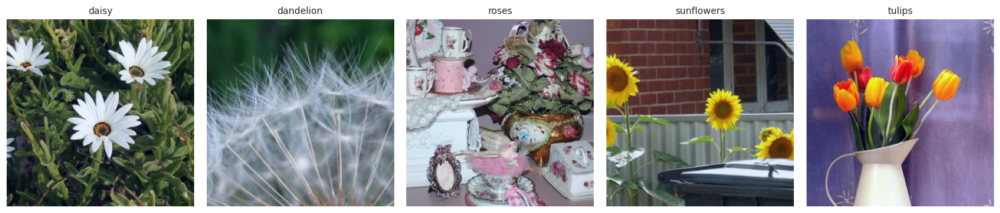

In [115]:
visualize_random_images_per_class(train_dataset)

In [152]:
# Load the DINOv2 model
model = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

Using cache found in /usr/home/j/017/tur60842/.cache/torch/hub/facebookresearch_dinov2_main
INFO:dinov2:using MLP layer as FFN


In [8]:
# Visualize embeddings using t-SNE
def visualize_tsne(embeddings, labels, classes):
    tsne = TSNE(n_components=2, random_state=42, perplexity=20)
    reduced_embeddings = tsne.fit_transform(embeddings)

    plt.figure(figsize=(12, 8))
    for class_idx, class_name in enumerate(classes):
        indices = labels == class_idx
        plt.scatter(reduced_embeddings[indices, 0], reduced_embeddings[indices, 1], alpha=0.6)

    plt.title("t-SNE Visualization of Embeddings")
    plt.show()

In [9]:
# Extract embeddings from a dataset
def extract_embeddings(data_loader, model):
    all_embeddings = []
    all_labels = []

    with torch.no_grad():
        for images, labels in tqdm(data_loader, desc="Feature Extraction"):
            images = images.to(device)

            # Forward pass through the model
            outputs = model(images)
            # Flatten embeddings if needed
            embeddings = outputs.view(outputs.size(0), -1)
            all_embeddings.append(embeddings.cpu().numpy())
            all_labels.append(labels.numpy())

    # Concatenate results
    all_embeddings = np.vstack(all_embeddings)
    all_labels = np.hstack(all_labels)

    return all_embeddings, all_labels

In [155]:
# Extract embeddings and labels
embeddings, labels = extract_embeddings(full_loader, model)

Feature Extraction: 100%|█████████████████████| 115/115 [00:14<00:00,  8.15it/s]


/usr/home/j/017/tur60842/miniconda3/envs/alttt/lib/python3.11/site-packages/cuml/internals/api_decorators.py:344: UserWarning: Starting from version 22.04, the default method of TSNE is 'fft'.
  return func(**kwargs)


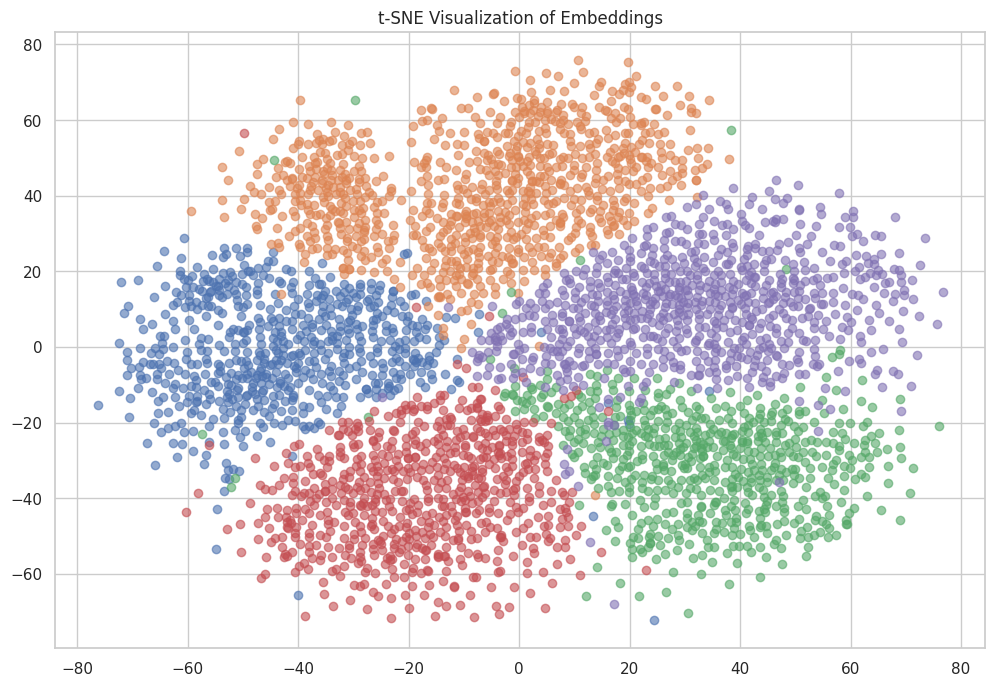

In [156]:
# Visualize using t-SNE
visualize_tsne(embeddings, labels, classes=train_dataset.classes)

In [12]:
num_classes = len(train_dataset.classes)

In [158]:
model.head = nn.Sequential(
    nn.Linear(384, num_classes),  # DINOv2 ViT-S/14 produces 384-dimensional embeddings
)

model = model.to(device)

In [10]:
def aggregate_metrics(preds, targets, num_classes):
    """Aggregate TP, FP, FN, and TN using torch tensor operations."""
    preds = torch.argmax(preds, dim=1)
    tp = torch.zeros(num_classes, device=preds.device)
    fp = torch.zeros(num_classes, device=preds.device)
    fn = torch.zeros(num_classes, device=preds.device)
    tn = torch.zeros(num_classes, device=preds.device)
    
    for cls in range(num_classes):
        tp[cls] = torch.sum((preds == cls) & (targets == cls))
        fp[cls] = torch.sum((preds == cls) & (targets != cls))
        fn[cls] = torch.sum((preds != cls) & (targets == cls))
        tn[cls] = torch.sum((preds != cls) & (targets != cls))
    
    return tp, fp, fn, tn


# Evaluation Function for Accuracy, Precision, Recall, and F1 Score
def compute_metrics(tp, fp, fn, tn):
    """Compute accuracy, precision, recall, and F1 score."""
    # Avoid division by zero
    precision = tp / (tp + fp + 1e-10)
    recall = tp / (tp + fn + 1e-10)
    f1_score = 2 * (precision * recall) / (precision + recall + 1e-10)
    accuracy = (tp + tn) / (tp + fp + fn + tn + 1e-10)
    return accuracy, precision, recall, f1_score

In [11]:
sns.set_theme(style="whitegrid")

def plot_metrics(train_metrics, val_metrics, metric_names):
    """
    Plot train and validation metrics in horizontally organized subplots 
    with color differentiation and professional styling.
    
    Args:
        train_metrics (list of lists): Scores for training metrics across epochs.
        val_metrics (list of lists): Scores for validation metrics across epochs.
        metric_names (list of str): Names of the metrics.
    """
    # Transpose the metrics to organize by individual metric
    train_metrics_by_name = list(zip(*train_metrics))  # One list per metric name
    val_metrics_by_name = list(zip(*val_metrics))

    num_metrics = len(metric_names)
    fig, axes = plt.subplots(1, num_metrics, figsize=(18, 6), sharey=True)

    epochs = range(1, len(train_metrics) + 1)
    train_color = sns.color_palette("tab10")[0]  # Train line color
    val_color = sns.color_palette("tab10")[1]    # Validation line color

    for ax, train_metric, val_metric, name in zip(axes, train_metrics_by_name, val_metrics_by_name, metric_names):
        ax.plot(epochs, train_metric, label=f"Train {name}", color=train_color, linewidth=2)
        ax.plot(epochs, val_metric, label=f"Val {name}", color=val_color, linewidth=2, linestyle="--")
        ax.set_xlabel("Epochs", fontsize=12)
        ax.set_title(name, fontsize=14, fontweight="bold")
        ax.legend(fontsize=10)
        ax.tick_params(axis="both", which="major", labelsize=10)

    # Add shared y-label
    fig.supylabel("Score", fontsize=14, fontweight="bold")
    
    # Add a shared title for the entire figure
    fig.suptitle("Training and Validation Metrics", fontsize=16, fontweight="bold")

    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit the shared title
    plt.show()

In [12]:
def plot_loss(train_loss, val_loss):
    """
    Plot training and validation loss over epochs with a professional style.
    
    Args:
        train_loss (list): Loss values for training across epochs.
        val_loss (list): Loss values for validation across epochs.
    """
    epochs = range(1, len(train_loss) + 1)
    train_color = sns.color_palette("tab10")[0]  # Train line color
    val_color = sns.color_palette("tab10")[1]    # Validation line color

    plt.figure(figsize=(18, 6))  # Adjust figure size
    plt.plot(epochs, train_loss, label="Train Loss", color=train_color, linewidth=2)
    plt.plot(epochs, val_loss, label="Val Loss", color=val_color, linewidth=2, linestyle="--")
    
    # Axis labels and title
    plt.xlabel("Epochs", fontsize=12)
    plt.ylabel("Loss", fontsize=12, fontweight="bold")
    plt.title("Training and Validation Loss", fontsize=16, fontweight="bold")
    
    # Add legend
    plt.legend(fontsize=10)
    
    # Enhance tick readability
    plt.tick_params(axis="both", which="major", labelsize=10)
    
    # Display grid for clarity
    plt.grid(visible=True)
    
    # Show the plot
    plt.tight_layout()
    plt.show()

In [13]:
def evaluate_model(model, data_loader, criterion, device, num_classes, lamb=None):
    """Evaluate the model on validation/test data."""
    model.eval()
    epoch_loss = 0.0
    tp, fp, fn, tn = torch.zeros(num_classes, device=device), torch.zeros(num_classes, device=device), \
                     torch.zeros(num_classes, device=device), torch.zeros(num_classes, device=device)
    
    with torch.no_grad():
        for images, labels in data_loader:
            images, labels = images.to(device), labels.to(device)
            
            # Forward pass
            outputs = model(images)
            
            # Compute loss
            if lamb:
                loss = criterion(outputs, labels, lamb=lamb)
            else:
                loss = criterion(outputs, labels)
            epoch_loss += loss.item()
            
            # Aggregate metrics
            batch_tp, batch_fp, batch_fn, batch_tn = aggregate_metrics(outputs, labels, num_classes)
            tp += batch_tp
            fp += batch_fp
            fn += batch_fn
            tn += batch_tn
    
    # Compute metrics
    accuracy, precision, recall, f1_score = compute_metrics(tp, fp, fn, tn)
    return epoch_loss / len(data_loader), accuracy, precision, recall, f1_score

In [14]:
def train_one_epoch(model, data_loader, criterion, optimizer, device, num_classes, lamb=None):
    """Train the model for one epoch."""
    model.train()
    epoch_loss = 0.0
    tp, fp, fn, tn = torch.zeros(num_classes, device=device), torch.zeros(num_classes, device=device), \
                     torch.zeros(num_classes, device=device), torch.zeros(num_classes, device=device)
    
    for images, labels in data_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        
        # Forward pass
        outputs = model(images)
        
        # Compute loss
        if lamb:
            loss = criterion(outputs, labels, lamb=lamb)
        else:
            loss = criterion(outputs, labels)
        epoch_loss += loss.item()
        
        # Backward pass
        loss.backward()
        optimizer.step()
        
        # Aggregate metrics
        batch_tp, batch_fp, batch_fn, batch_tn = aggregate_metrics(outputs, labels, num_classes)
        tp += batch_tp
        fp += batch_fp
        fn += batch_fn
        tn += batch_tn
    
    # Compute epoch metrics
    accuracy, precision, recall, f1_score = compute_metrics(tp, fp, fn, tn)
    return epoch_loss / len(data_loader), accuracy, precision, recall, f1_score

In [15]:
def freeze_model(model):
    for name, param in model.named_parameters():
        # Freeze patch embed
        if "patch_embed" in name:
            param.requires_grad = False
        # Freeze blocks 0-7 (keep 8-11 unfrozen)
        elif "blocks" in name:
            block_idx = int(name.split('.')[1])
            if block_idx < 8:
                param.requires_grad = False
        # Unfreeze the rest (head and last 4 blocks)
        else:
            param.requires_grad = True

In [16]:
def train_model(model, train_loader, val_loader, num_epochs, optimizer, criterion, device, num_classes, save_path="best.pth", lamb=None):
    """Train the model, evaluate it, and save the best model based on validation performance."""
    global train_losses, val_losses
    global train_metrics, val_metrics

    train_losses, val_losses = [], []
    train_metrics, val_metrics = [], []
    
    best_metric = float('inf')  # Initialize best metric (e.g., highest F1 score)

    global metric_names
    metric_names = ["Accuracy", "Precision", "Recall", "F1 Score"]

    for epoch in range(num_epochs):
        # Training phase
        train_loss, train_acc, train_prec, train_recall, train_f1 = train_one_epoch(
            model, train_loader, criterion, optimizer, device, num_classes, lamb
        )
        train_losses.append(train_loss)
        train_metrics.append([train_acc.mean().item(), train_prec.mean().item(), train_recall.mean().item(), train_f1.mean().item()])
        
        # Validation phase
        val_loss, val_acc, val_prec, val_recall, val_f1 = evaluate_model(
            model, val_loader, criterion, device, num_classes, lamb
        )
        val_losses.append(val_loss)
        val_metrics.append([val_acc.mean().item(), val_prec.mean().item(), val_recall.mean().item(), val_f1.mean().item()])
        
        # Save the best model based on validation F1 score
        if val_loss < best_metric:
            best_metric = val_loss
            torch.save(model.state_dict(), save_path)
            print(f"New best model saved at epoch {epoch+1}")

        # Print epoch results
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f}, Acc: {train_acc.mean().item():.4f}, Prec: {train_prec.mean().item():.4f}, Recall: {train_recall.mean().item():.4f}, F1: {train_f1.mean().item():.4f}")
        print(f"Val Loss: {val_loss:.4f}, Acc: {val_acc.mean().item():.4f}, Prec: {val_prec.mean().item():.4f}, Recall: {val_recall.mean().item():.4f}, F1: {val_f1.mean().item():.4f}")
    
        # Plot metrics
        plot_metrics(train_metrics, val_metrics, metric_names)  
        plot_loss(train_losses, val_losses)
    print(f"Best model saved with score: {best_metric:.4f} at {save_path}")

In [36]:
optimizer_ce = torch.optim.AdamW(model.parameters(), lr=1e-3)

In [37]:
cross_entropy_loss = torch.nn.CrossEntropyLoss()

In [38]:
freeze_model(model)

In [178]:
ce_best_model_name = 'cross_entropy_best'

New best model saved at epoch 1
Epoch 1/10
Train Loss: 0.1625, Acc: 0.9789, Prec: 0.9464, Recall: 0.9457, F1: 0.9461
Val Loss: 0.7353, Acc: 0.9401, Prec: 0.8537, Recall: 0.8552, F1: 0.8506


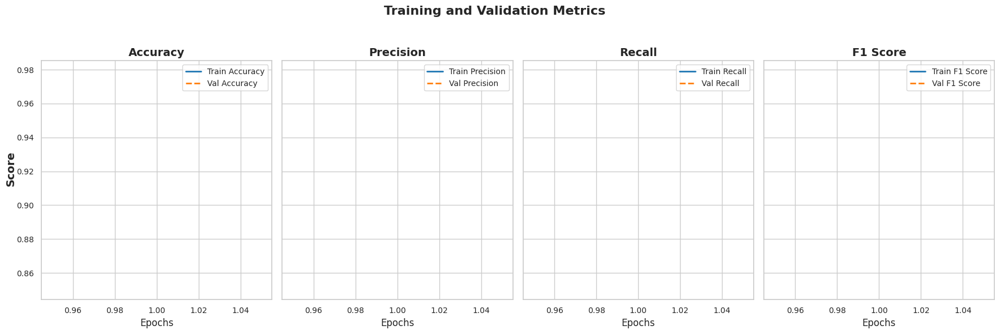

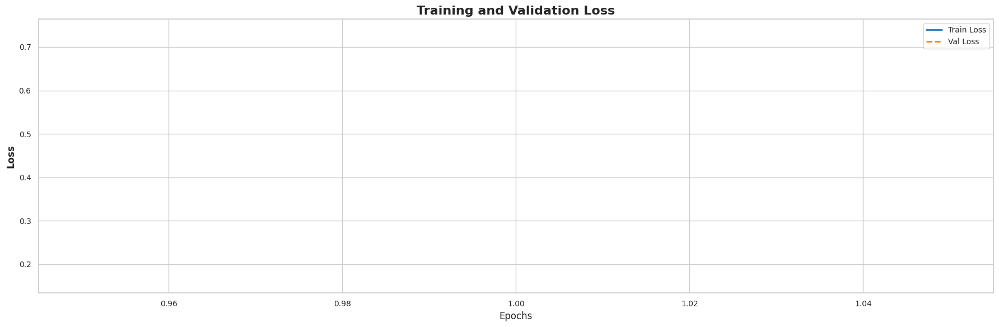

New best model saved at epoch 2
Epoch 2/10
Train Loss: 0.0685, Acc: 0.9911, Prec: 0.9779, Recall: 0.9783, F1: 0.9781
Val Loss: 0.4973, Acc: 0.9499, Prec: 0.8774, Recall: 0.8767, F1: 0.8741


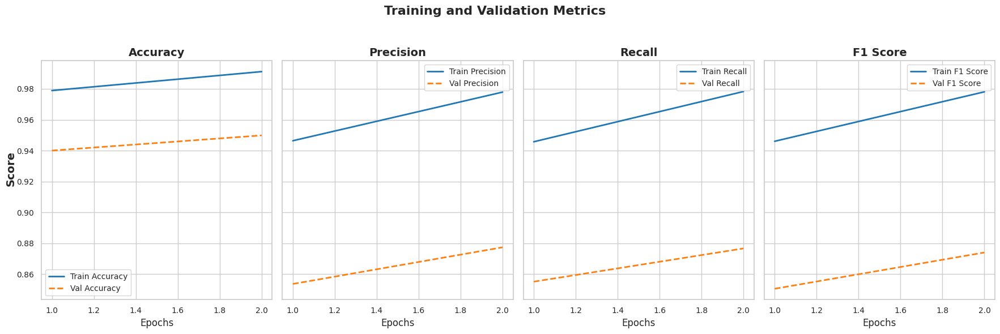

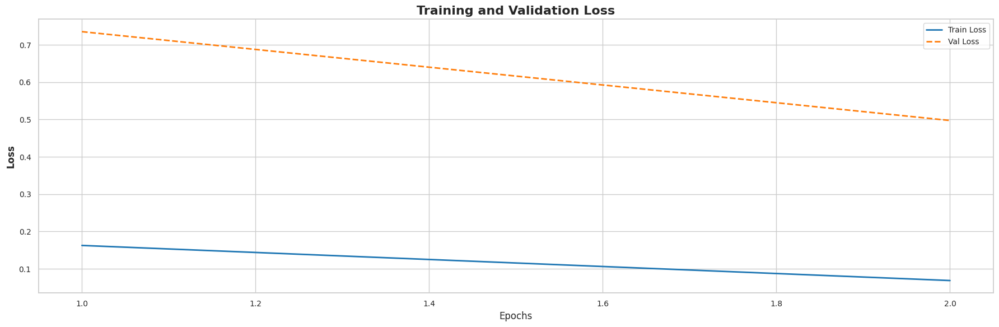

New best model saved at epoch 3
Epoch 3/10
Train Loss: 0.0681, Acc: 0.9903, Prec: 0.9759, Recall: 0.9757, F1: 0.9758
Val Loss: 0.4888, Acc: 0.9477, Prec: 0.8708, Recall: 0.8642, F1: 0.8665


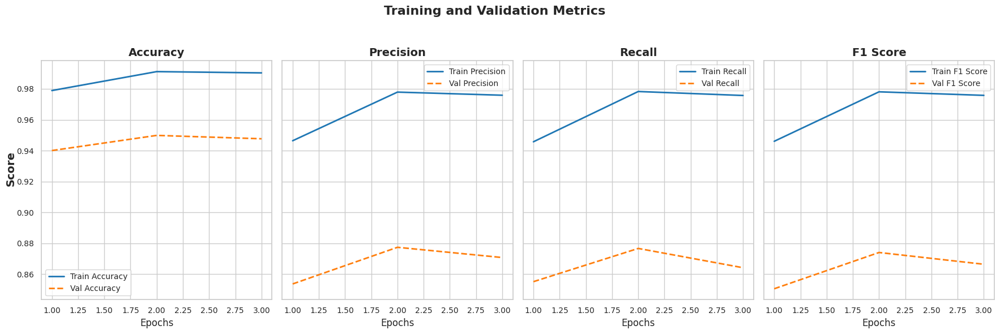

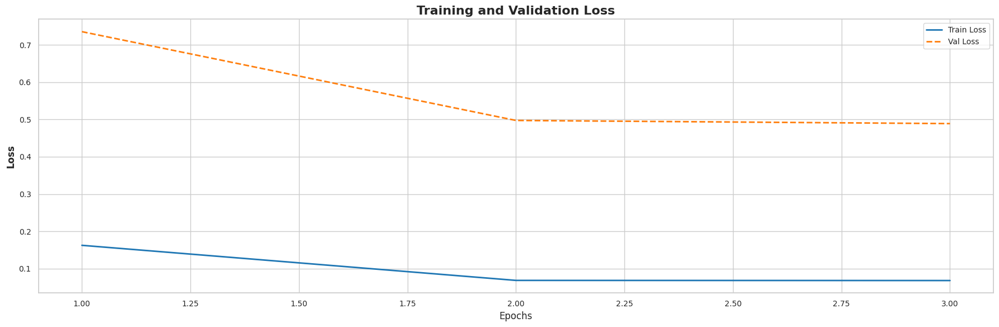

Epoch 4/10
Train Loss: 0.0795, Acc: 0.9896, Prec: 0.9741, Recall: 0.9748, F1: 0.9744
Val Loss: 0.5983, Acc: 0.9433, Prec: 0.8689, Recall: 0.8618, F1: 0.8579


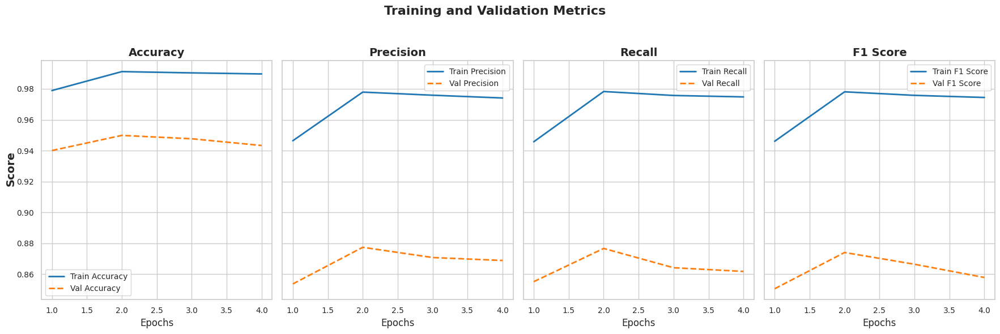

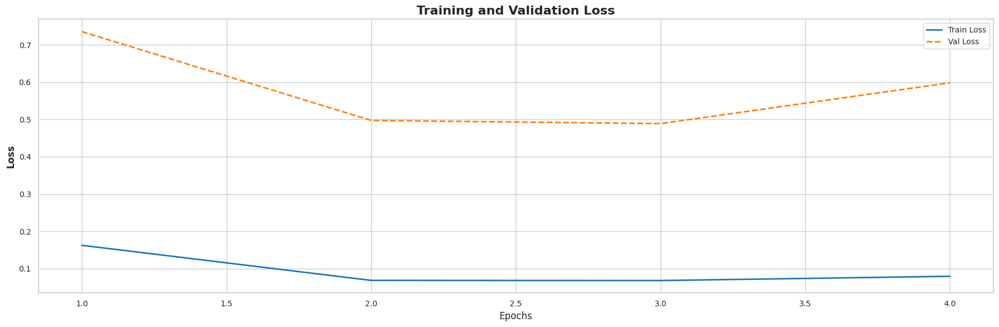

Epoch 5/10
Train Loss: 0.0532, Acc: 0.9918, Prec: 0.9801, Recall: 0.9790, F1: 0.9795
Val Loss: 0.6047, Acc: 0.9553, Prec: 0.8923, Recall: 0.8870, F1: 0.8875


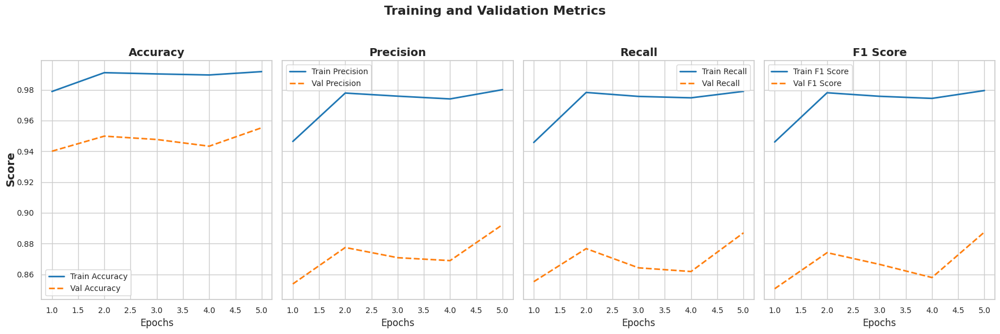

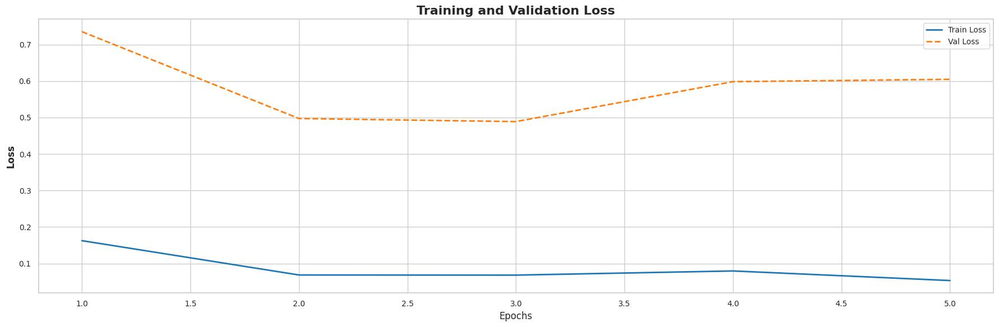

Epoch 6/10
Train Loss: 0.0635, Acc: 0.9914, Prec: 0.9781, Recall: 0.9778, F1: 0.9780
Val Loss: 0.6354, Acc: 0.9488, Prec: 0.8698, Recall: 0.8722, F1: 0.8696


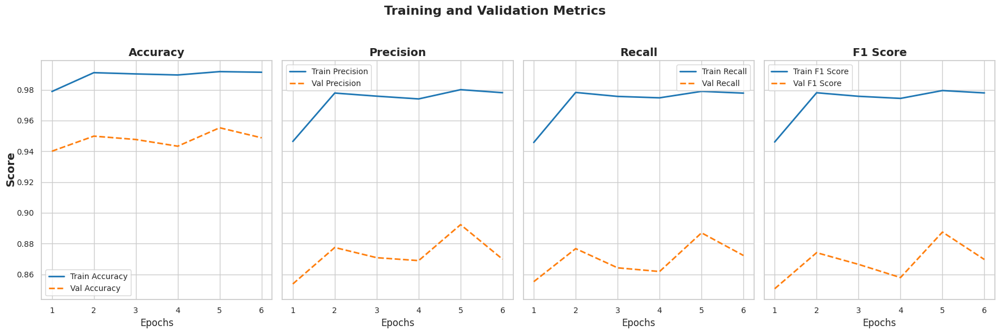

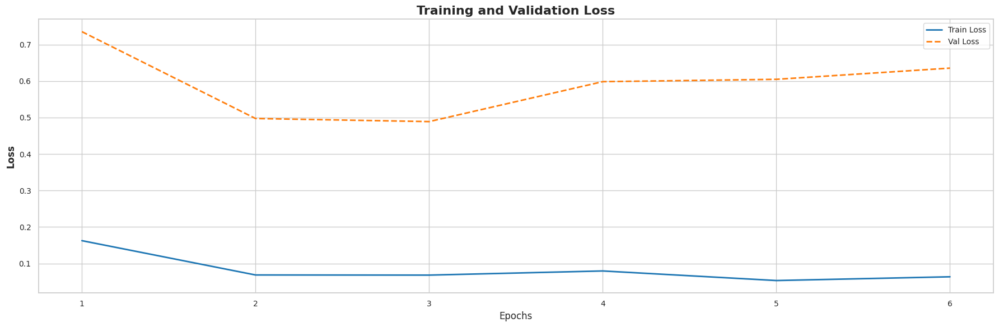

New best model saved at epoch 7
Epoch 7/10
Train Loss: 0.0793, Acc: 0.9899, Prec: 0.9743, Recall: 0.9746, F1: 0.9745
Val Loss: 0.4861, Acc: 0.9510, Prec: 0.8750, Recall: 0.8773, F1: 0.8756


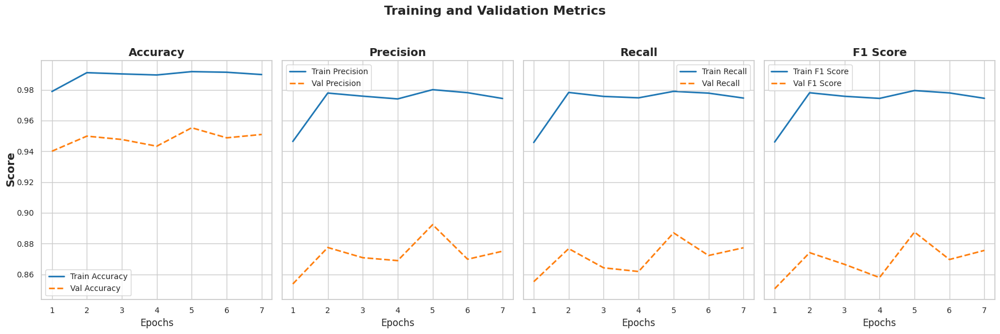

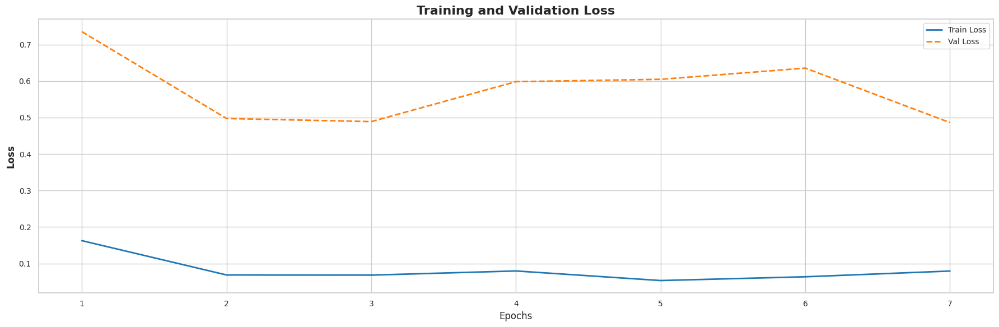

Epoch 8/10
Train Loss: 0.0165, Acc: 0.9982, Prec: 0.9955, Recall: 0.9957, F1: 0.9956
Val Loss: 0.5646, Acc: 0.9564, Prec: 0.8935, Recall: 0.8889, F1: 0.8897


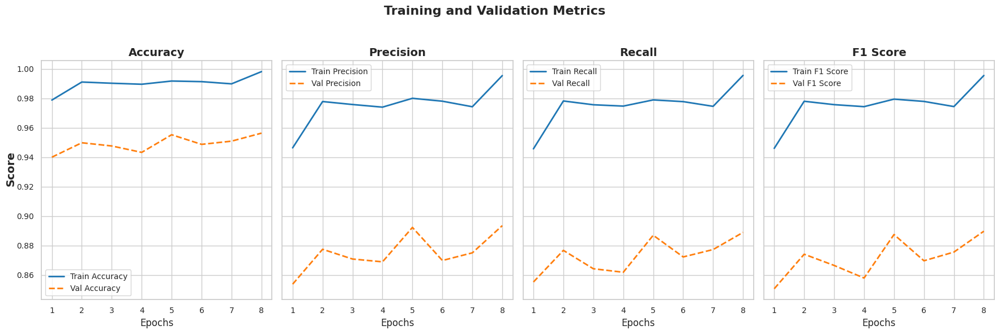

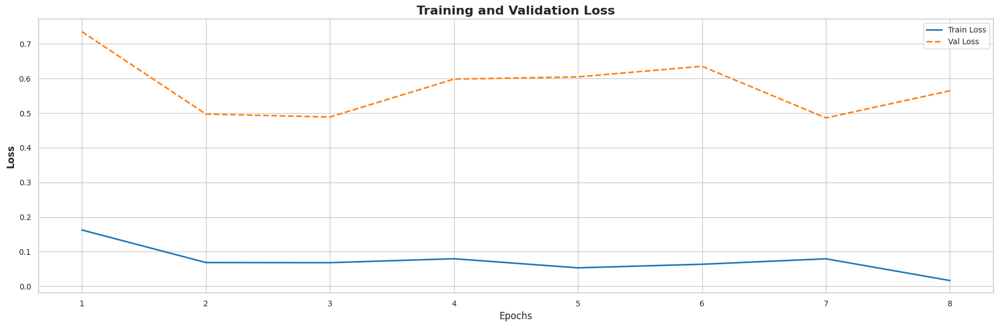

Epoch 9/10
Train Loss: 0.0140, Acc: 0.9986, Prec: 0.9967, Recall: 0.9965, F1: 0.9966
Val Loss: 0.8507, Acc: 0.9510, Prec: 0.8808, Recall: 0.8780, F1: 0.8739


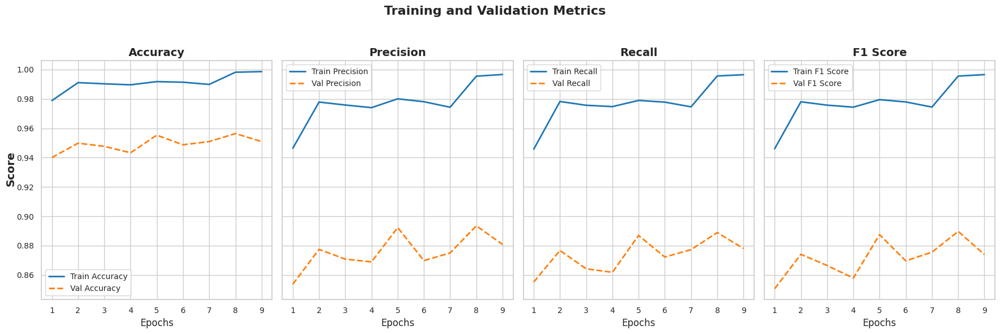

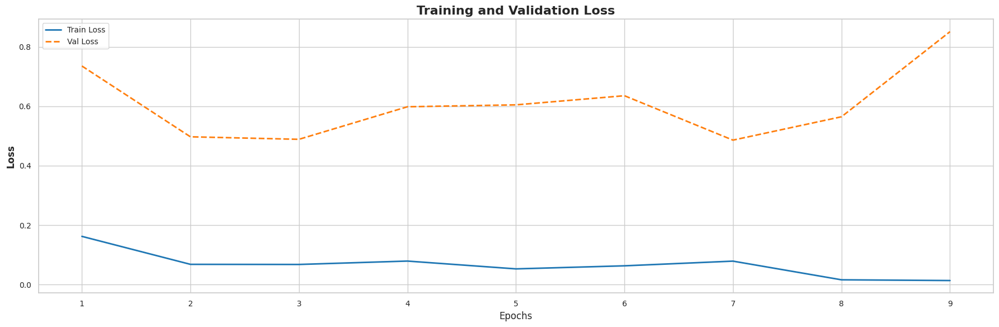

Epoch 10/10
Train Loss: 0.0760, Acc: 0.9899, Prec: 0.9752, Recall: 0.9744, F1: 0.9748
Val Loss: 0.8164, Acc: 0.9183, Prec: 0.8125, Recall: 0.8025, F1: 0.7991


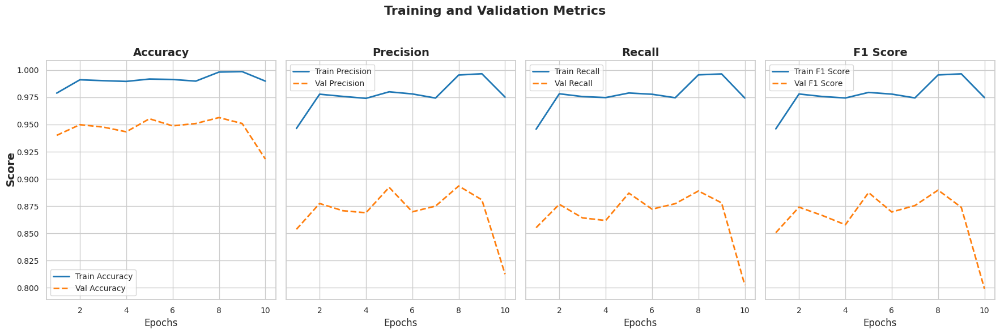

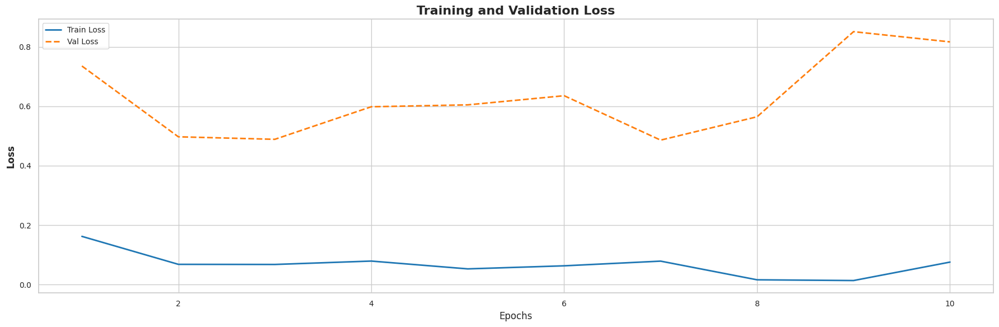

Best model saved with score: 0.4861 at cross_entropy_best.pt


In [39]:
train_model(model, 
            train_loader, 
            val_loader, 
            num_epochs=10, 
            optimizer=optimizer_ce, 
            criterion=cross_entropy_loss, 
            device=device, 
            num_classes=num_classes,
            save_path=f'{ce_best_model_name}.pt')

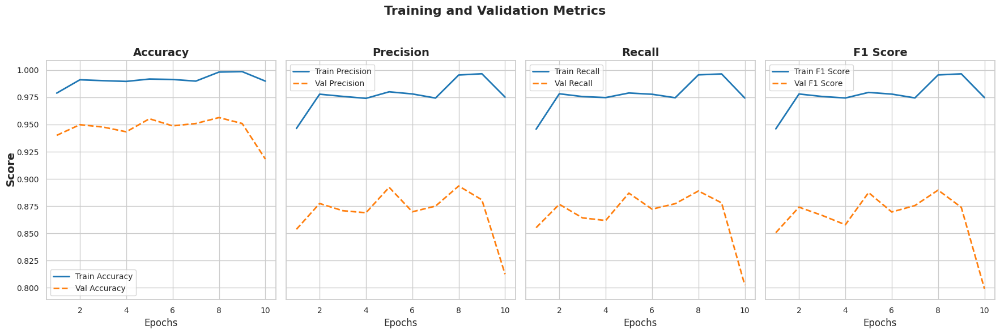

In [40]:
plot_metrics(train_metrics, val_metrics, metric_names)  

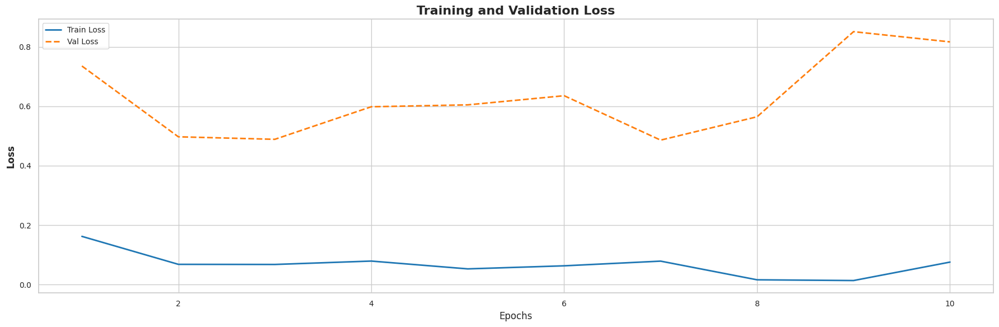

In [41]:
plot_loss(train_losses, val_losses)


In [51]:
torch.save(train_metrics, f'train_metrics_{ce_best_model_name}.pt')
torch.save(val_metrics, f'val_metrics_{ce_best_model_name}.pt')

In [160]:
# Load pretrained model
model.load_state_dict(torch.load(f'{ce_best_model_name}.pt'))

<All keys matched successfully>

In [53]:
# Test Metrics on the best model
test_loss, test_acc, test_prec, test_recall, test_f1 = evaluate_model(
    model, test_loader, evidential_classification, device, num_classes
)

print(f"Test Loss: {test_loss:.4f}, Acc: {test_acc.mean().item():.4f}, Prec: {test_prec.mean().item():.4f}, Recall: {test_recall.mean().item():.4f}, F1: {test_f1.mean().item():.4f}")


Test Loss: -105.4365, Acc: 0.9455, Prec: 0.8632, Recall: 0.8607, F1: 0.8614


In [33]:
class GradCAM:
    def __init__(self, model, target_layer):
        """
        Initialize Grad-CAM with a model and the target layer.
        Args:
            model (torch.nn.Module): The model to visualize.
            target_layer (torch.nn.Module): The layer to capture activations and gradients.
        """
        self.model = model
        self.target_layer = target_layer
        self.activations = None
        self.gradients = None

        # Register hooks to capture activations and gradients
        self.target_layer.register_forward_hook(self.save_activation)
        self.target_layer.register_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def generate_heatmap(self, input_tensor, class_idx):
        """
        Generate a Grad-CAM heatmap for Vision Transformers.
        Args:
            input_tensor (torch.Tensor): Input image tensor.
            class_idx (int): Index of the target class for visualization.
        Returns:
            heatmap (np.ndarray): Grad-CAM heatmap.
        """
        # Forward pass
        output = self.model(input_tensor)
        self.model.zero_grad()
    
        # Backward pass for the target class
        one_hot = torch.zeros_like(output)
        one_hot[0, class_idx] = 1
        output.backward(gradient=one_hot)
    
        # Extract gradients and activations
        gradients = self.gradients.detach().cpu().numpy()[0]  # Shape: (num_patches+1, embedding_dim)
        activations = self.activations.detach().cpu().numpy()[0]  # Shape: (num_patches+1, embedding_dim)
    
        # Exclude the class token (first token)
        gradients = gradients[1:]  # Exclude the first token
        activations = activations[1:]  # Exclude the first token
    
        # Compute weights using global average pooling over the embedding dimension
        weights = np.mean(gradients, axis=0)  # Shape: (embedding_dim,)
    
        # Compute weighted sum of activations
        cam = np.dot(activations, weights)  # Shape: (num_patches,)
    
        # Reshape CAM to image patch layout
        num_patches = activations.shape[0]
        grid_size = int(num_patches**0.5)  # Compute grid size
        cam = cam.reshape(grid_size, grid_size)  # Reshape to grid
    
        # Resize to match input image size
        cam = cv2.resize(cam, (input_tensor.shape[2], input_tensor.shape[3]))
    
        # Normalize heatmap to range [0, 1]
        heatmap = (cam - np.min(cam)) / (np.max(cam) - np.min(cam) + 1e-10)
        return heatmap

In [55]:
# Target layer for Grad-CAM
target_layer = model.blocks[-1].norm1  # Last layer normalization output

# Initialize Grad-CAM
gradcam = GradCAM(model, target_layer)

In [56]:
def generate_class_heatmaps(gradcam, test_dataset, model, num_classes, device, correct=True):
    """
    Generate and plot Grad-CAM heatmaps for random samples from each class 
    and for each target class. Allows selection of correctly or incorrectly 
    predicted samples. Class names are displayed using `test_dataset.classes`.

    Args:
        gradcam (GradCAM): Grad-CAM instance.
        test_dataset (Dataset): Dataset to select samples from.
        model (torch.nn.Module): The trained model.
        num_classes (int): Total number of classes.
        device (torch.device): Device (CPU or GPU).
        correct (bool): If True, selects correctly predicted samples; otherwise, incorrectly predicted samples.
    """
    class_names = test_dataset.classes  # Get class names from dataset
    dataset_indices = list(range(len(test_dataset)))
    random.shuffle(dataset_indices)

    # Randomly select samples based on prediction correctness
    samples = {}
    for idx in dataset_indices:
        image, label = test_dataset[idx]
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            model_output = model(image)
            predicted_class = torch.argmax(model_output, dim=1).item()

        is_correct = (predicted_class == label)
        if is_correct == correct and label not in samples:
            samples[label] = (image.squeeze(0), label, predicted_class)
        if len(samples) == num_classes:  # Stop if all classes are covered
            break

    if len(samples) < num_classes:
        print(f"Warning: Not enough samples found for the specified condition ('correct={correct}').")

    # Create a grid of heatmaps
    fig, axes = plt.subplots(num_classes, num_classes + 1, figsize=(18, 18))
    fig.suptitle(
        f"Grad-CAM Heatmaps: Rows = Sample Classes, Columns = Target Classes ({'Correct' if correct else 'Incorrect'} Predictions)", 
        fontsize=20, y=0.92
    )
    
    for i, (sample_label, (image, true_label, predicted_class)) in enumerate(samples.items()):
        with torch.no_grad():
            model_output = model(image.unsqueeze(0))

        for j in range(num_classes + 1):
            ax = axes[i, j]

            if j == 0:
                # Plot the original image in the first column
                img_np = image.permute(1, 2, 0).cpu().numpy()
                img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min())  # Normalize
                ax.imshow(img_np)
                ax.set_title(
                    f"GT: {class_names[true_label]} | Pred: {class_names[predicted_class]}",
                    fontsize=10,
                    color="blue"
                )
                ax.axis("off")
            else:
                # Generate Grad-CAM heatmap for the target class (j-1)
                target_class = j - 1
                heatmap = gradcam.generate_heatmap(image.unsqueeze(0), target_class)
                img_np = image.permute(1, 2, 0).cpu().numpy()
                img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min())  # Normalize
                
                # Overlay heatmap on the image
                heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)
                heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
                overlay = 0.5 * img_np + 0.5 * heatmap / 255
                overlay = overlay / overlay.max()  # Normalize
                
                ax.imshow(overlay)
                ax.set_title(f"Target: {class_names[target_class]}", fontsize=10, color="green")
                ax.axis("off")
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # Adjust title position
    plt.show()


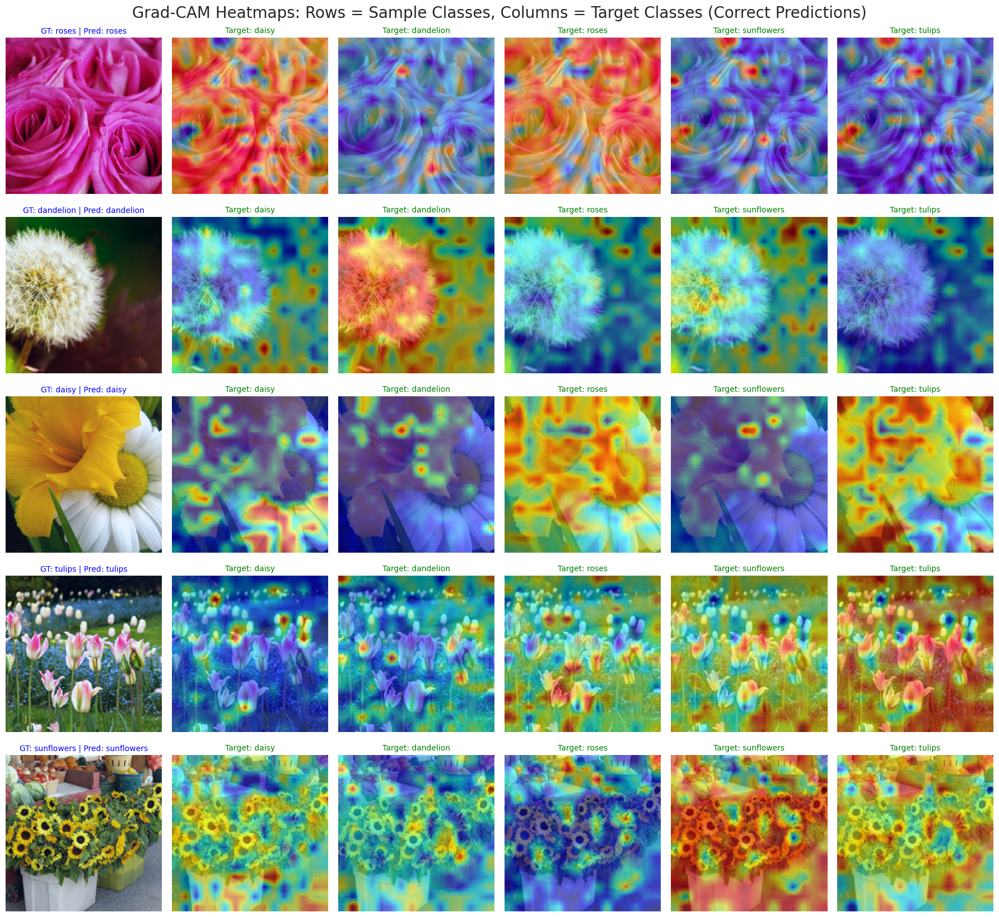

In [58]:
# Generate and plot Grad-CAM heatmaps
generate_class_heatmaps(
    gradcam=gradcam,
    test_dataset=test_dataset,
    model=model,
    num_classes=num_classes,
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    correct=True
)

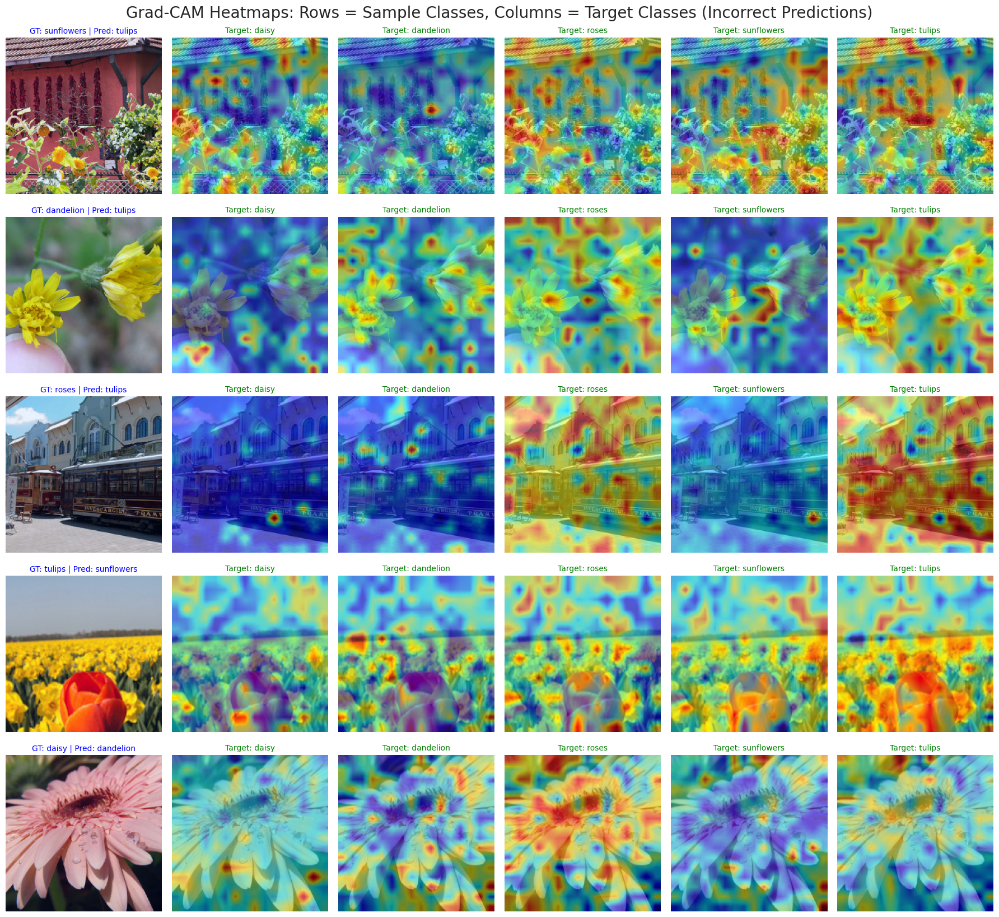

In [59]:
# Generate and plot Grad-CAM heatmaps
generate_class_heatmaps(
    gradcam=gradcam,
    test_dataset=test_dataset,
    model=model,
    num_classes=num_classes,
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    correct=False
)

In [161]:
model.head = nn.Identity()

In [164]:
# Extract embeddings and labels
embeddings, labels = extract_embeddings(full_loader, model)

Feature Extraction: 100%|█████████████████████| 115/115 [00:13<00:00,  8.47it/s]


/usr/home/j/017/tur60842/miniconda3/envs/alttt/lib/python3.11/site-packages/cuml/internals/api_decorators.py:344: UserWarning: Starting from version 22.04, the default method of TSNE is 'fft'.
  return func(**kwargs)


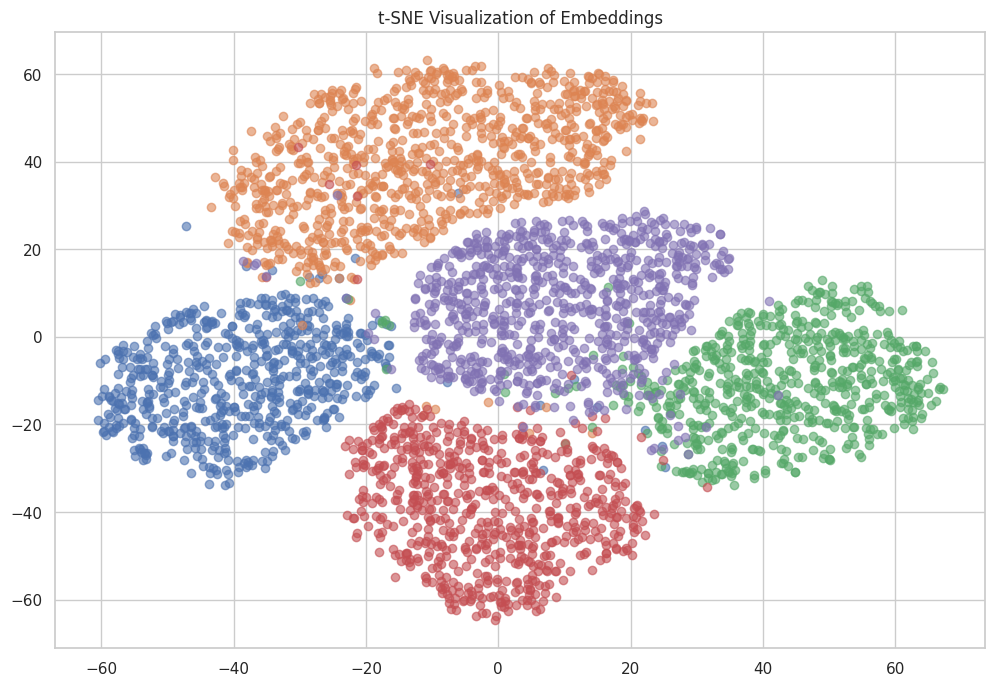

In [165]:
# Visualize using t-SNE
visualize_tsne(embeddings, labels, classes=train_dataset.classes)

# Evidential Training

In [166]:
# Load the DINOv2 model
model = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

Using cache found in /usr/home/j/017/tur60842/.cache/torch/hub/facebookresearch_dinov2_main
INFO:dinov2:using MLP layer as FFN


In [167]:
model.head = nn.Sequential(
    Dirichlet(384, num_classes) # DINOv2 ViT-S/14 produces 384-dimensional embeddings
)

model = model.to(device)

In [168]:
optimizer_el = torch.optim.AdamW(model.parameters(), lr=1e-4)

In [183]:
ev_best_model_name = 'evidential_loss_best'

In [120]:
evidential_loss = evidential_classification

In [121]:
freeze_model(model)

New best model saved at epoch 1
Epoch 1/10
Train Loss: 0.3368, Acc: 0.9281, Prec: 0.8208, Recall: 0.8044, F1: 0.8031
Val Loss: 0.1414, Acc: 0.9826, Prec: 0.9586, Recall: 0.9579, F1: 0.9570


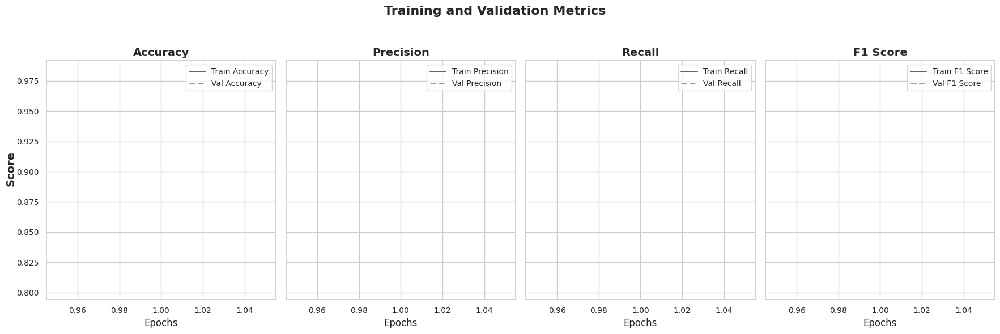

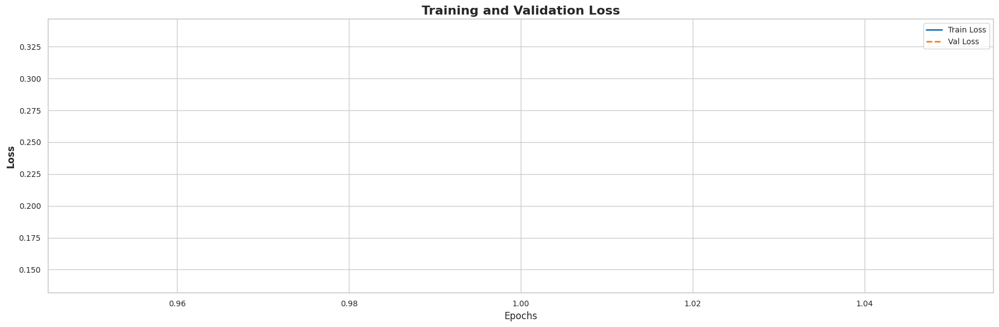

New best model saved at epoch 2
Epoch 2/10
Train Loss: 0.1185, Acc: 0.9857, Prec: 0.9628, Recall: 0.9635, F1: 0.9631
Val Loss: 0.1171, Acc: 0.9858, Prec: 0.9672, Recall: 0.9618, F1: 0.9639


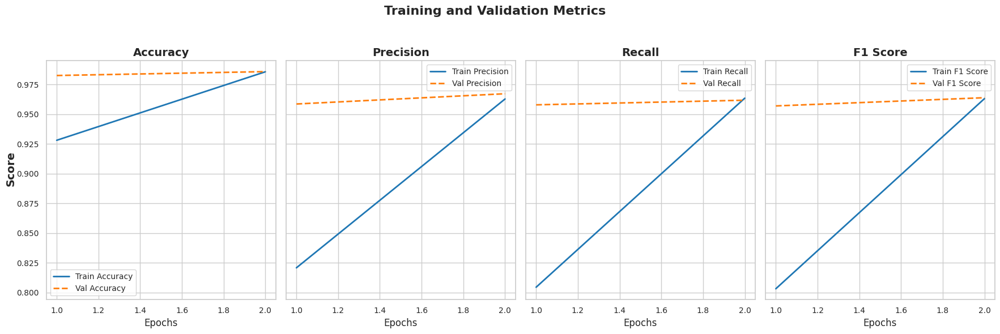

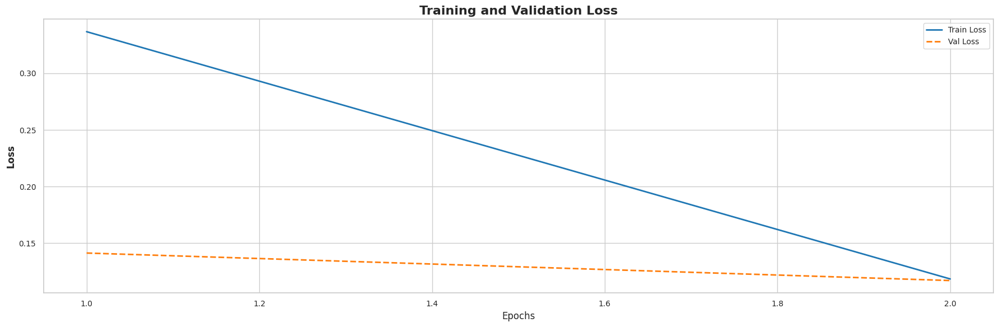

New best model saved at epoch 3
Epoch 3/10
Train Loss: 0.0967, Acc: 0.9877, Prec: 0.9687, Recall: 0.9689, F1: 0.9688
Val Loss: 0.1078, Acc: 0.9858, Prec: 0.9650, Recall: 0.9645, F1: 0.9643


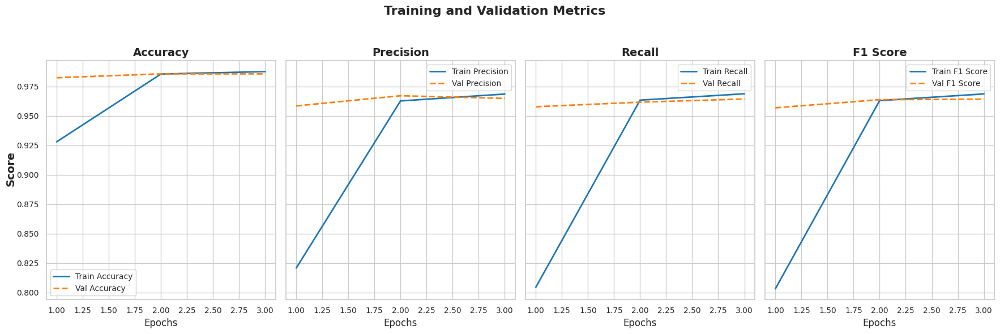

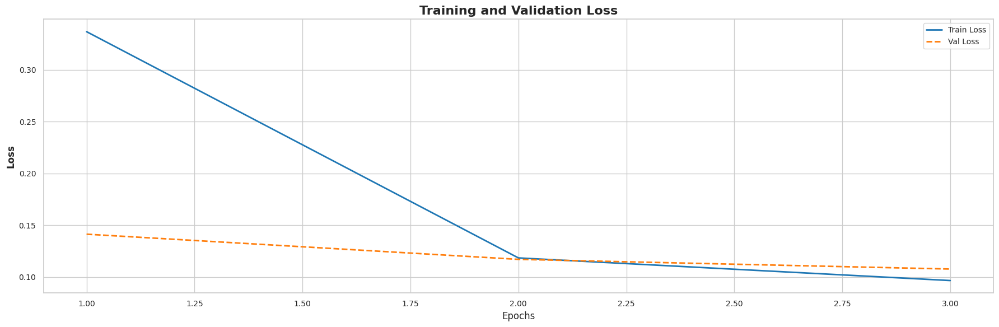

Epoch 4/10
Train Loss: 0.0722, Acc: 0.9917, Prec: 0.9790, Recall: 0.9793, F1: 0.9792
Val Loss: 0.1273, Acc: 0.9837, Prec: 0.9590, Recall: 0.9581, F1: 0.9585


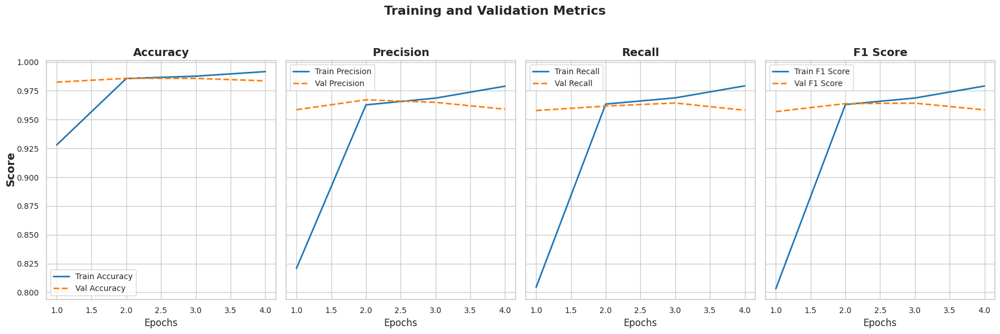

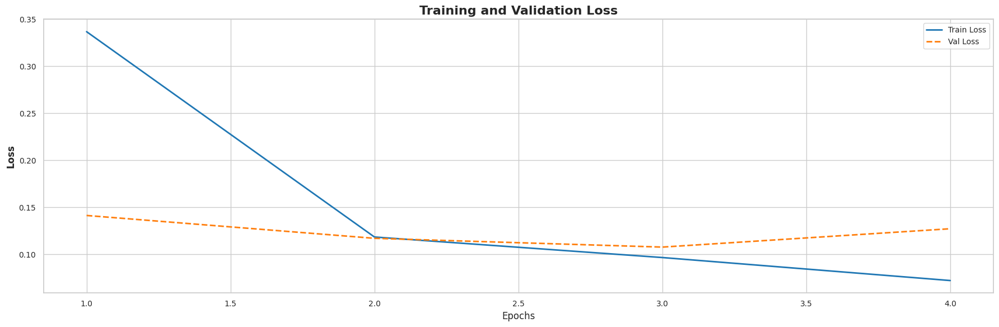

Epoch 5/10
Train Loss: 0.0829, Acc: 0.9905, Prec: 0.9754, Recall: 0.9763, F1: 0.9758
Val Loss: 0.1726, Acc: 0.9760, Prec: 0.9418, Recall: 0.9381, F1: 0.9386


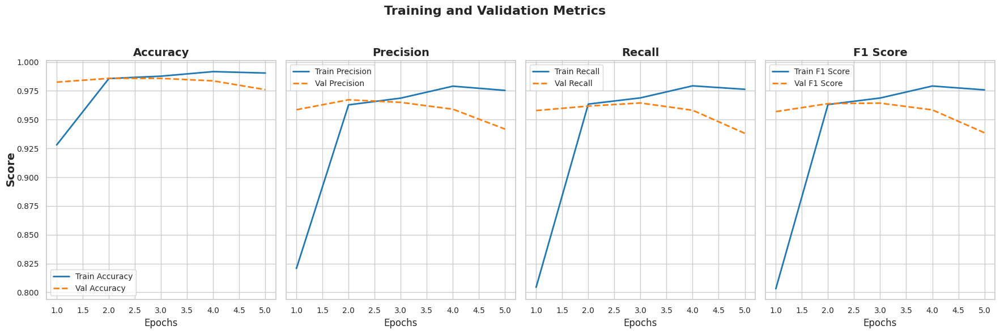

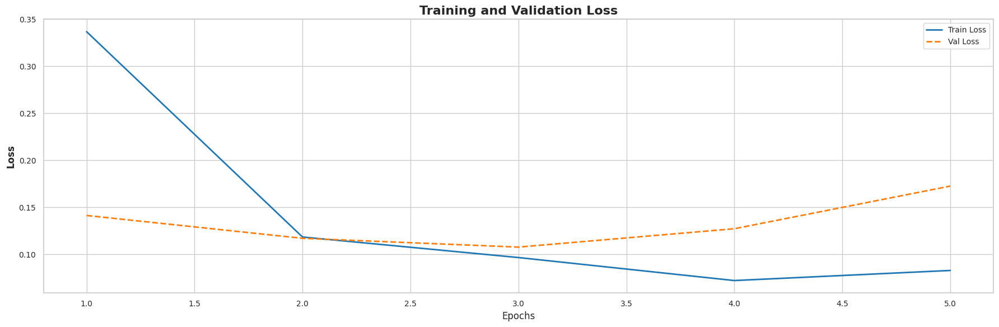

Epoch 6/10
Train Loss: 0.0638, Acc: 0.9935, Prec: 0.9834, Recall: 0.9834, F1: 0.9834
Val Loss: 0.1305, Acc: 0.9793, Prec: 0.9505, Recall: 0.9463, F1: 0.9481


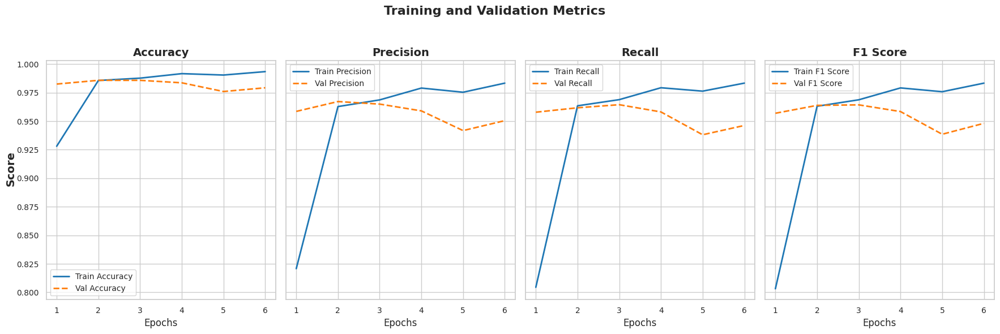

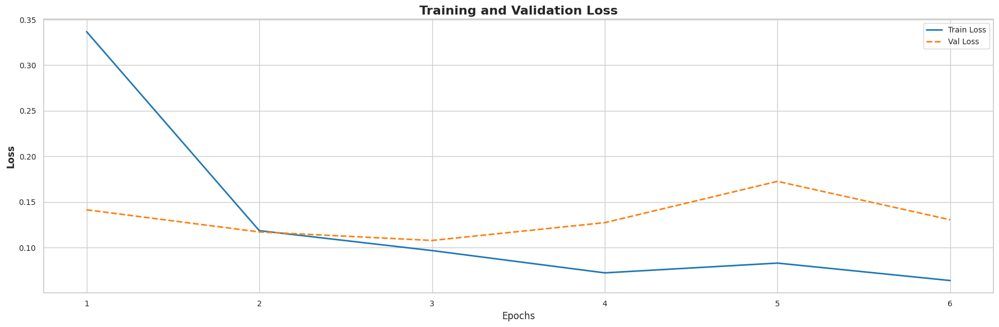

New best model saved at epoch 7
Epoch 7/10
Train Loss: 0.0680, Acc: 0.9920, Prec: 0.9793, Recall: 0.9794, F1: 0.9793
Val Loss: 0.1051, Acc: 0.9837, Prec: 0.9579, Recall: 0.9595, F1: 0.9586


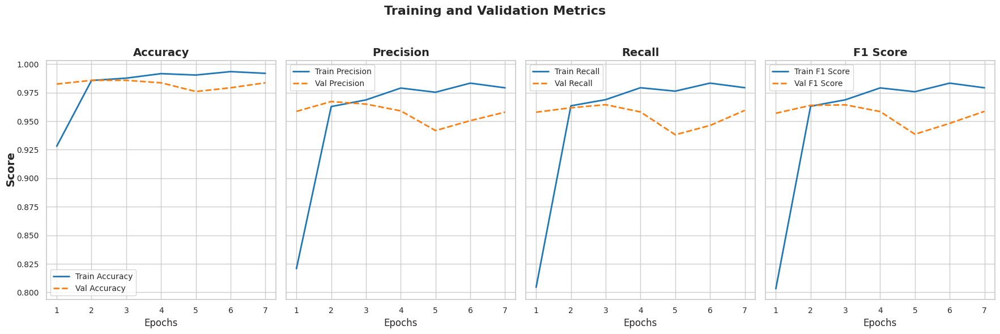

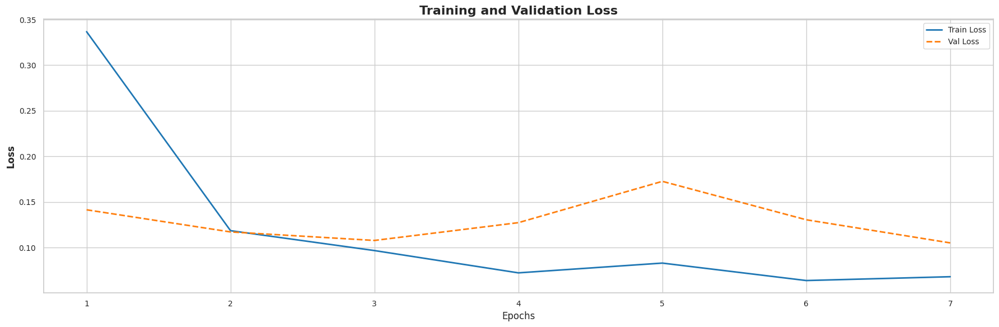

Epoch 8/10
Train Loss: 0.0435, Acc: 0.9965, Prec: 0.9910, Recall: 0.9911, F1: 0.9910
Val Loss: 0.1458, Acc: 0.9782, Prec: 0.9467, Recall: 0.9470, F1: 0.9451


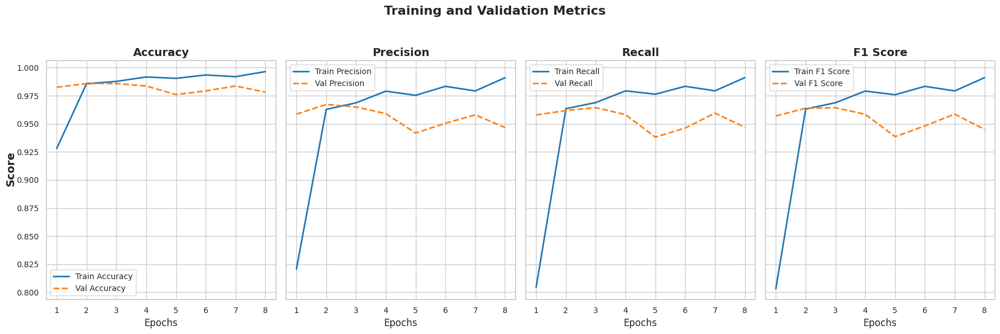

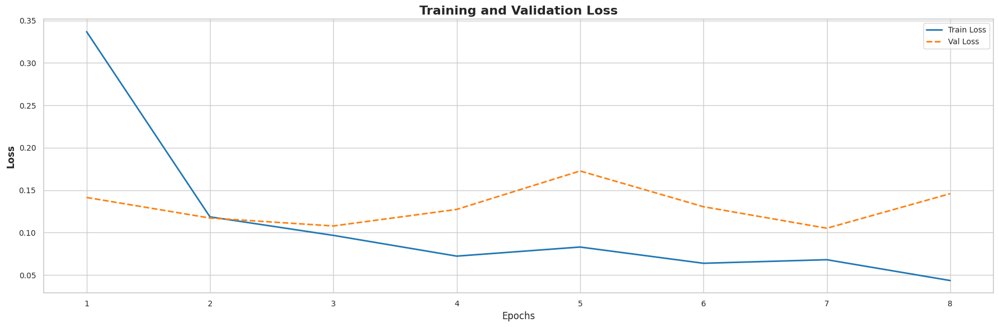

Epoch 9/10
Train Loss: 0.0882, Acc: 0.9886, Prec: 0.9707, Recall: 0.9711, F1: 0.9708
Val Loss: 0.1345, Acc: 0.9771, Prec: 0.9457, Recall: 0.9449, F1: 0.9423


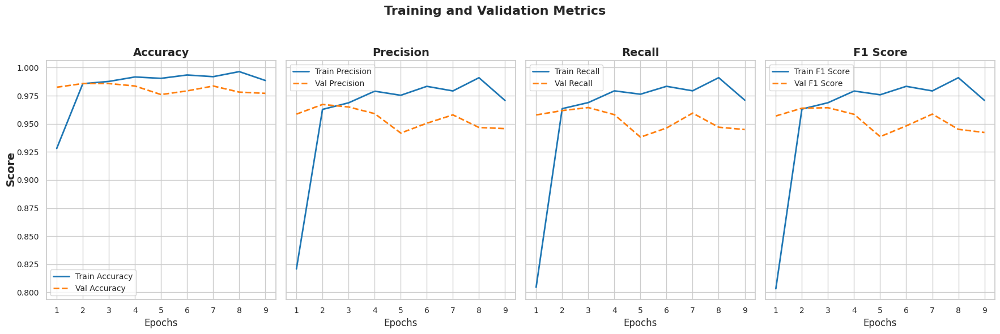

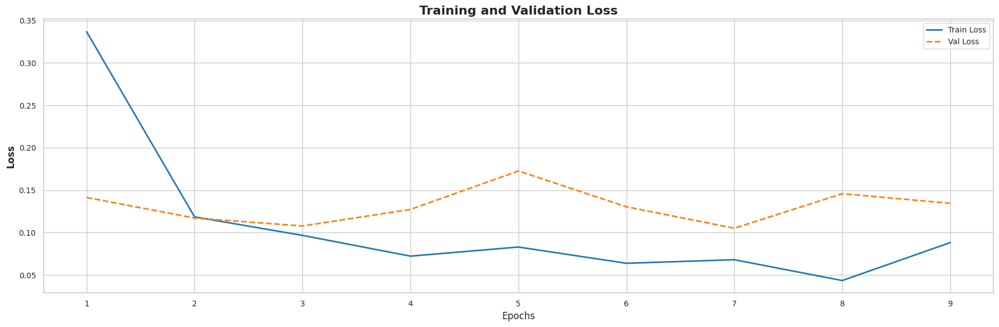

New best model saved at epoch 10
Epoch 10/10
Train Loss: 0.0466, Acc: 0.9955, Prec: 0.9884, Recall: 0.9884, F1: 0.9884
Val Loss: 0.0821, Acc: 0.9891, Prec: 0.9717, Recall: 0.9721, F1: 0.9719


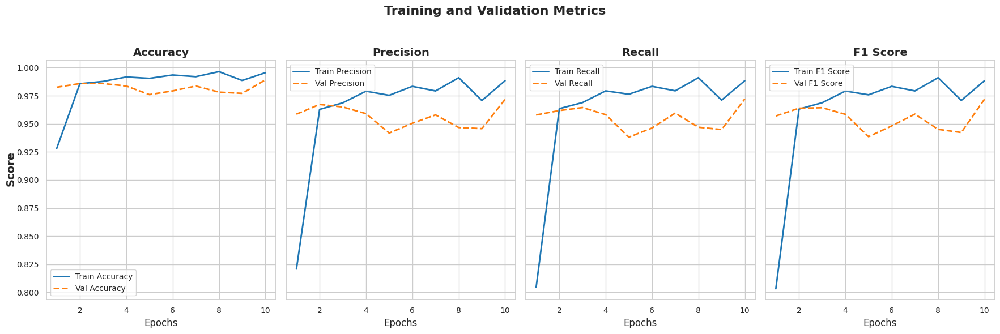

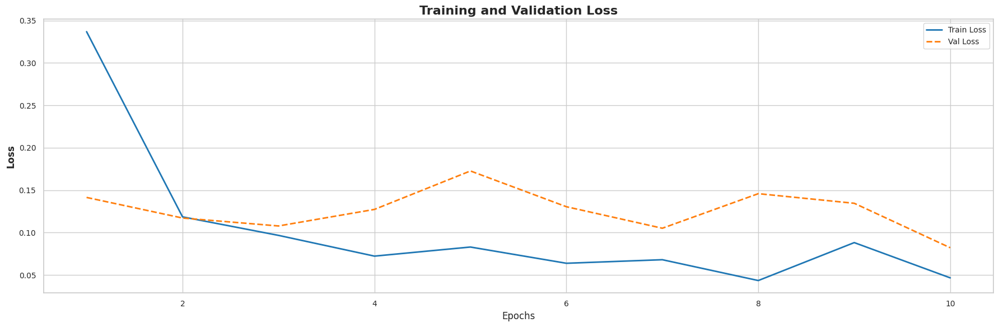

Best model saved with score: 0.0821 at evidential_loss_best.pt


In [124]:
train_model(model, 
            train_loader, 
            val_loader, 
            num_epochs=10, 
            optimizer=optimizer_el, 
            criterion=evidential_loss, 
            device=device, 
            num_classes=num_classes,
            save_path=f'{ev_best_model_name}.pt',
            lamb=0.2)

In [125]:
torch.save(train_metrics, f'train_metrics_{ev_best_model_name}.pt')
torch.save(val_metrics, f'val_metrics_{ev_best_model_name}.pt')

In [171]:
# Load pretrained model
model.load_state_dict(torch.load(f'{ev_best_model_name}.pt'))

<All keys matched successfully>

In [127]:
# Test Metrics on the best model
test_loss, test_acc, test_prec, test_recall, test_f1 = evaluate_model(
    model, test_loader, evidential_classification, device, num_classes
)

print(f"Test Loss: {test_loss:.4f}, Acc: {test_acc.mean().item():.4f}, Prec: {test_prec.mean().item():.4f}, Recall: {test_recall.mean().item():.4f}, F1: {test_f1.mean().item():.4f}")


Test Loss: 0.2724, Acc: 0.9869, Prec: 0.9655, Recall: 0.9661, F1: 0.9655


In [128]:
# Target layer for Grad-CAM
target_layer = model.blocks[-1].norm1  # Last layer normalization output

# Initialize Grad-CAM
gradcam = GradCAM(model, target_layer)

/usr/home/j/017/tur60842/miniconda3/envs/alttt/lib/python3.11/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


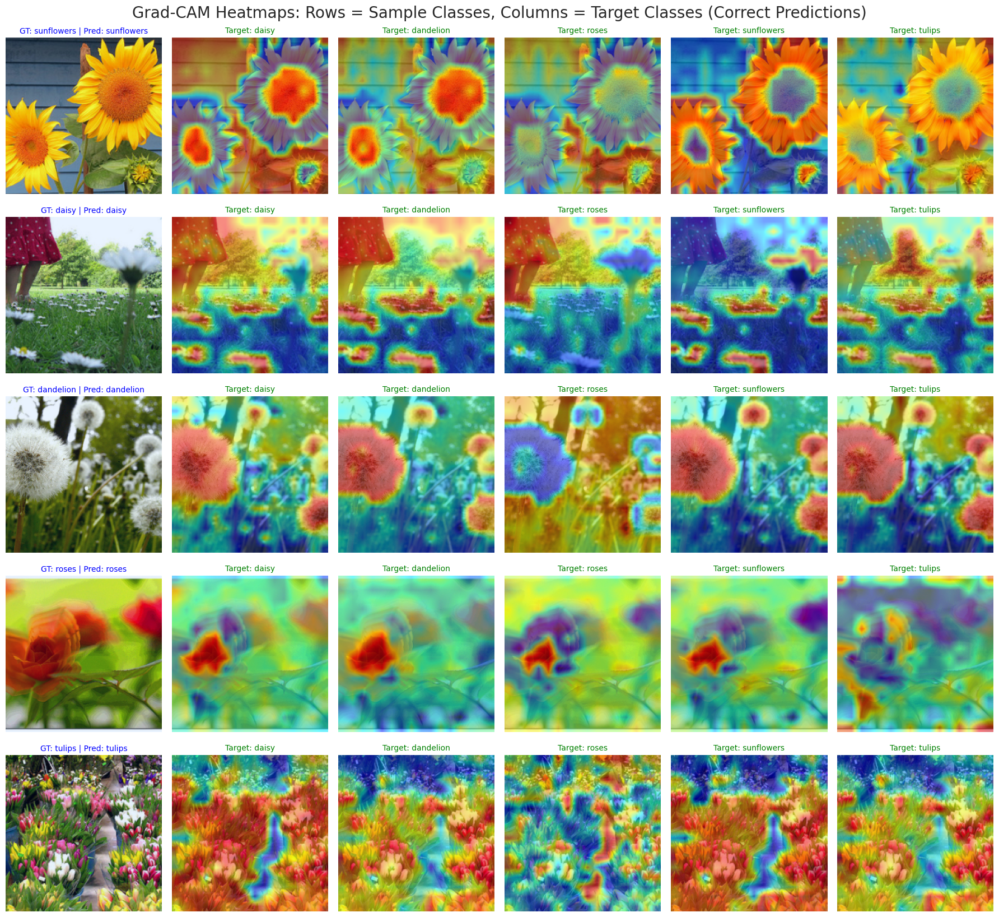

In [129]:
# Generate and plot Grad-CAM heatmaps
generate_class_heatmaps(
    gradcam=gradcam,
    test_dataset=test_dataset,
    model=model,
    num_classes=num_classes,
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    correct=True
)

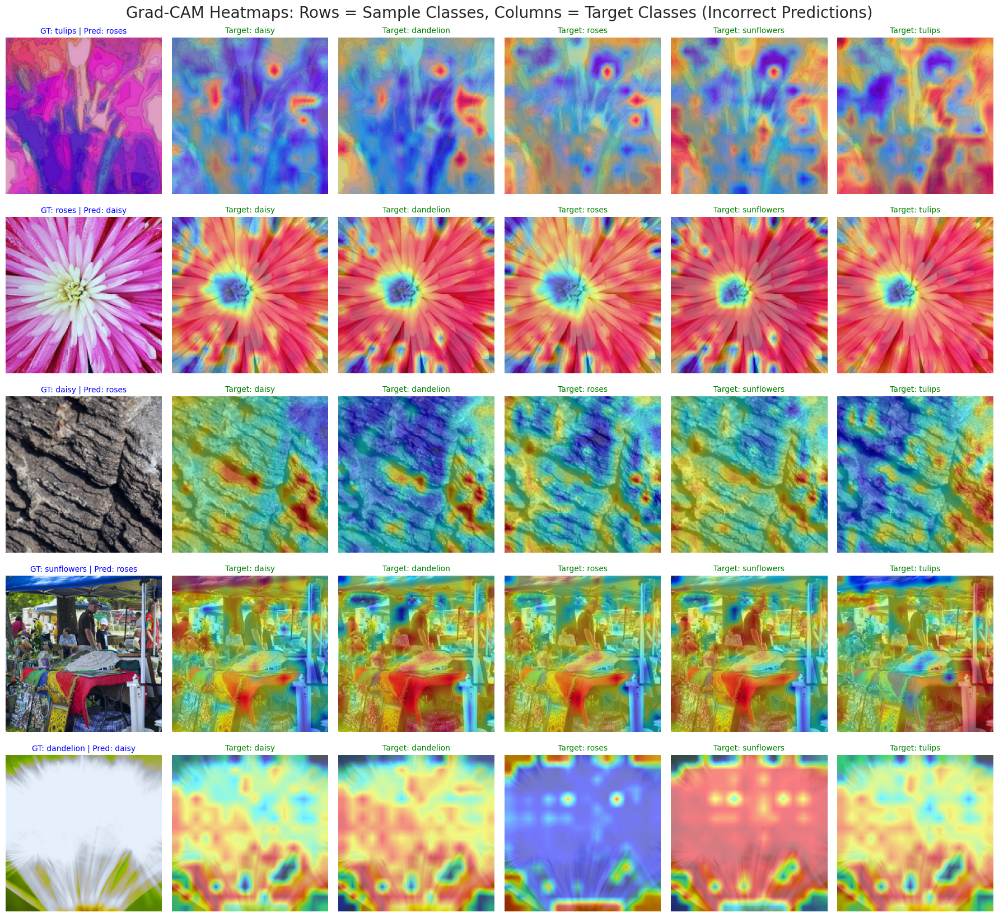

In [134]:
# Generate and plot Grad-CAM heatmaps
generate_class_heatmaps(
    gradcam=gradcam,
    test_dataset=test_dataset,
    model=model,
    num_classes=num_classes,
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    correct=False
)

In [172]:
model.head = nn.Identity()

In [174]:
# Extract embeddings and labels
embeddings, labels = extract_embeddings(full_loader, model)

Feature Extraction: 100%|█████████████████████| 115/115 [00:13<00:00,  8.45it/s]


/usr/home/j/017/tur60842/miniconda3/envs/alttt/lib/python3.11/site-packages/cuml/internals/api_decorators.py:344: UserWarning: Starting from version 22.04, the default method of TSNE is 'fft'.
  return func(**kwargs)


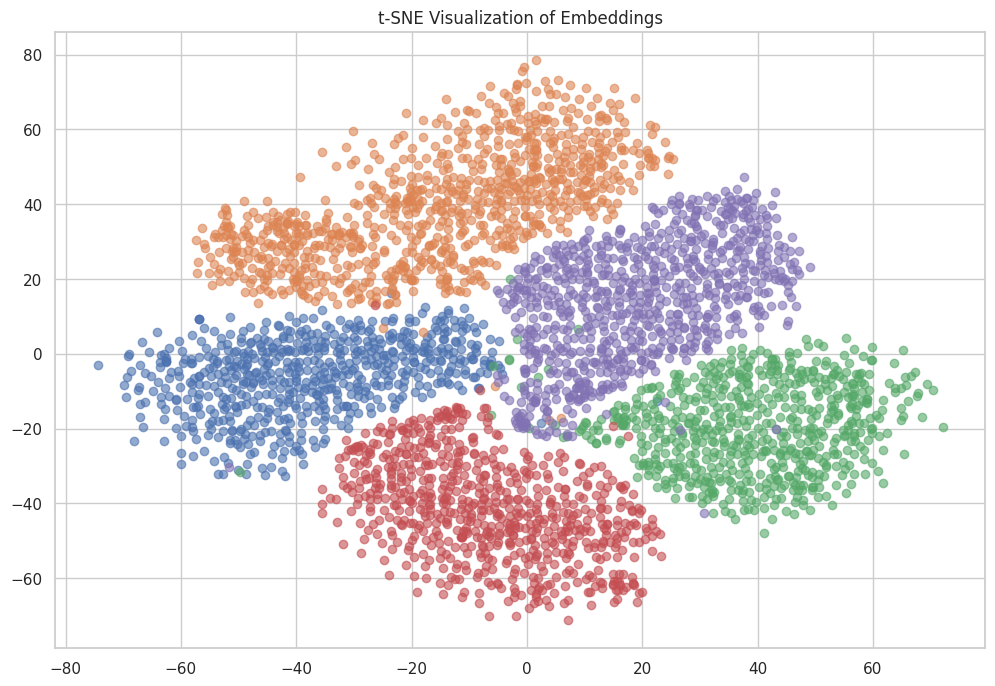

In [175]:
# Visualize using t-SNE
visualize_tsne(embeddings, labels, classes=train_dataset.classes)

# Cross Entropy vs. Evidential

In [22]:
device = 'cuda'
num_classes = len(train_dataset.classes)

In [25]:
ce_best_model_name = 'cross_entropy_best'
ev_best_model_name = 'evidential_loss_best'

In [26]:
ce_model = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')

ce_model.head = nn.Sequential(
    nn.Linear(384, num_classes),  # DINOv2 ViT-S/14 produces 384-dimensional embeddings
)

ce_model = ce_model.to(device)

ce_model.load_state_dict(torch.load(f'{ce_best_model_name}.pt'))

Using cache found in /usr/home/j/017/tur60842/.cache/torch/hub/facebookresearch_dinov2_main
INFO:dinov2:using MLP layer as FFN


<All keys matched successfully>

In [28]:
ev_model = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')

ev_model.head = nn.Sequential(
    Dirichlet(384, num_classes) # DINOv2 ViT-S/14 produces 384-dimensional embeddings
)

ev_model = ev_model.to(device)

ev_model.load_state_dict(torch.load(f'{ev_best_model_name}.pt'))

Using cache found in /usr/home/j/017/tur60842/.cache/torch/hub/facebookresearch_dinov2_main
INFO:dinov2:using MLP layer as FFN


<All keys matched successfully>

In [41]:
def calculate_uncertainties(alpha):
    alpha_0 = torch.sum(alpha, dim=-1, keepdim=True)
    expected_probs = alpha / alpha_0
    var = expected_probs * (1 - expected_probs) / (alpha_0 + 1)
    total_uncertainty = -torch.sum(expected_probs * torch.log(expected_probs + 1e-9), dim=-1)
    epistemic_uncertainty = 1 / alpha_0.squeeze()
    aleatoric_uncertainty = torch.sum(var, dim=-1)
    
    return total_uncertainty.item(), epistemic_uncertainty.item(), aleatoric_uncertainty.item()

In [42]:
def compute_entropy(probs):
    """
    Compute entropy for a probability distribution.
    """
    return -torch.sum(probs * torch.log(probs + 1e-9), dim=-1).item()

In [43]:
def compare_models_heatmaps(
    gradcam_evidential, gradcam_cross_entropy, 
    test_dataset, model_evidential, model_cross_entropy, 
    num_classes, device, condition="right_wrong"
):
    """
    Compare Grad-CAM heatmaps for two models based on their predictions
    with uncertainty measures.
    """
    class_names = test_dataset.classes  # Get class names from the dataset
    dataset_indices = list(range(len(test_dataset)))
    random.shuffle(dataset_indices)

    # Collect samples based on the condition
    samples = {}
    for idx in dataset_indices:
        image, label = test_dataset[idx]
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            # Evidential model outputs
            alpha = model_evidential(image)
            evidential_pred = torch.argmax(alpha, dim=1).item()
            
            # Compute uncertainties using provided method
            total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty = calculate_uncertainties(alpha)
            
            # Cross-Entropy model outputs
            cross_entropy_output = model_cross_entropy(image)
            cross_entropy_probs = F.softmax(cross_entropy_output, dim=1)
            cross_entropy_pred = torch.argmax(cross_entropy_probs, dim=1).item()

            # Entropy as uncertainty for Cross-Entropy model
            entropy = compute_entropy(cross_entropy_probs)

        # Determine correctness for each model
        is_evidential_correct = (evidential_pred == label)
        is_cross_entropy_correct = (cross_entropy_pred == label)

        # Filter based on the specified condition
        if condition == "right_wrong" and is_evidential_correct and not is_cross_entropy_correct:
            samples[label] = (image.squeeze(0), label, cross_entropy_pred, evidential_pred, is_cross_entropy_correct, is_evidential_correct, entropy, total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty)
        elif condition == "both_right" and is_evidential_correct and is_cross_entropy_correct:
            samples[label] = (image.squeeze(0), label, cross_entropy_pred, evidential_pred, is_cross_entropy_correct, is_evidential_correct, entropy, total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty)
        elif condition == "both_wrong" and not is_evidential_correct and not is_cross_entropy_correct:
            samples[label] = (image.squeeze(0), label, cross_entropy_pred, evidential_pred, is_cross_entropy_correct, is_evidential_correct, entropy, total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty)
        elif condition == "wrong_right" and not is_evidential_correct and is_cross_entropy_correct:
            samples[label] = (image.squeeze(0), label, cross_entropy_pred, evidential_pred, is_cross_entropy_correct, is_evidential_correct, entropy, total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty)

        if len(samples) == num_classes:  # Stop if all classes are covered
            break

    if len(samples) < num_classes:
        print(f"Warning: Not enough samples found for the specified condition ('{condition}').")

    # Create a grid of heatmaps
    fig, axes = plt.subplots(num_classes, 3, figsize=(15, 15))
    fig.suptitle(
        f"Grad-CAM Heatmaps Comparison ({condition.replace('_', ' ').title()}) with Uncertainty Measures", 
        fontsize=20, y=1.02  # Adjust the position of the title
    )

    for i, (sample_label, (image, true_label, cross_entropy_pred, evidential_pred, cross_entropy_correct, evidential_correct, entropy, total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty)) in enumerate(samples.items()):
        # Plot original image in the first column
        ax = axes[i, 0]
        img_np = image.permute(1, 2, 0).cpu().numpy()
        img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min())  # Normalize
        ax.imshow(img_np)
        ax.set_title(f"Original\nGT: {class_names[true_label]}", fontsize=10, color="black")
        ax.axis("off")

        for j, (gradcam, model_name, pred, is_correct, unc) in enumerate(
            zip([gradcam_cross_entropy, gradcam_evidential], 
                ["Cross-Entropy", "Evidential"], 
                [cross_entropy_pred, evidential_pred], 
                [cross_entropy_correct, evidential_correct],
                [[f"Entropy: {entropy:.3f}"], [f"Epistemic: {epistemic_uncertainty:.3f}", f"Aleatoric: {aleatoric_uncertainty:.3f}", f"Entropy: {total_uncertainty:.3f}"]])
        ):
            ax = axes[i, j + 1]

            # Generate Grad-CAM heatmap for the predicted class
            heatmap = gradcam.generate_heatmap(image.unsqueeze(0), pred)
            img_np = image.permute(1, 2, 0).cpu().numpy()
            img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min())  # Normalize

            # Overlay heatmap on the image
            heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)
            heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
            overlay = 0.5 * img_np + 0.5 * heatmap / 255
            overlay = overlay / overlay.max()  # Normalize

            title_color = "green" if is_correct else "red"  # Set title color based on correctness
            ax.imshow(overlay)
            ax.set_title(
                f"{model_name}\nPred: {class_names[pred]}\n" + "\n".join(unc),
                fontsize=8, color=title_color
            )
            ax.axis("off")

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)  # Adjust title position
    plt.show()


In [44]:
# Target layer for Grad-CAM
ev_target_layer = ev_model.blocks[-1].norm1  # Last layer normalization output
ce_target_layer = ce_model.blocks[-1].norm1  # Last layer normalization output

# Initialize Grad-CAM
ev_gradcam = GradCAM(ev_model, ev_target_layer)
ce_gradcam = GradCAM(ce_model, ce_target_layer)

In [45]:
# Set models to evaluation mode
ev_model = ev_model.eval()
ce_model = ce_model.eval()

/usr/home/j/017/tur60842/miniconda3/envs/alttt/lib/python3.11/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/usr/home/j/017/tur60842/miniconda3/envs/alttt/lib/python3.11/site-packages/torch/autograd/graph.py:744: UserWarning: Attempting to run cuBLAS, but there was no current CUDA context! Attempting to set the primary context... (Triggered internally at /home/conda/feedstock_root/build_artifacts/libtorch_1718580740865/work/aten/src/ATen/cuda/CublasHandlePool.cpp:135.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


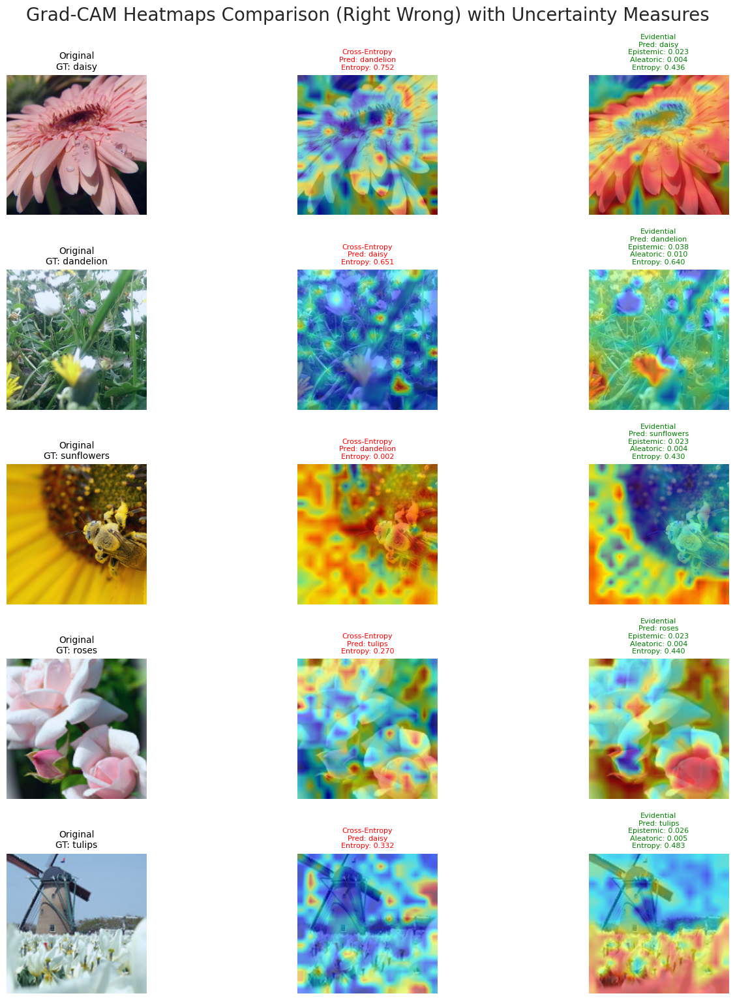

In [46]:
# Compare models
compare_models_heatmaps(
    gradcam_evidential=ev_gradcam,
    gradcam_cross_entropy=ce_gradcam,
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    num_classes=len(test_dataset.classes),  # Dynamically set number of classes
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    condition="right_wrong"  # Options: "right_wrong", "both_right", "both_wrong"
)

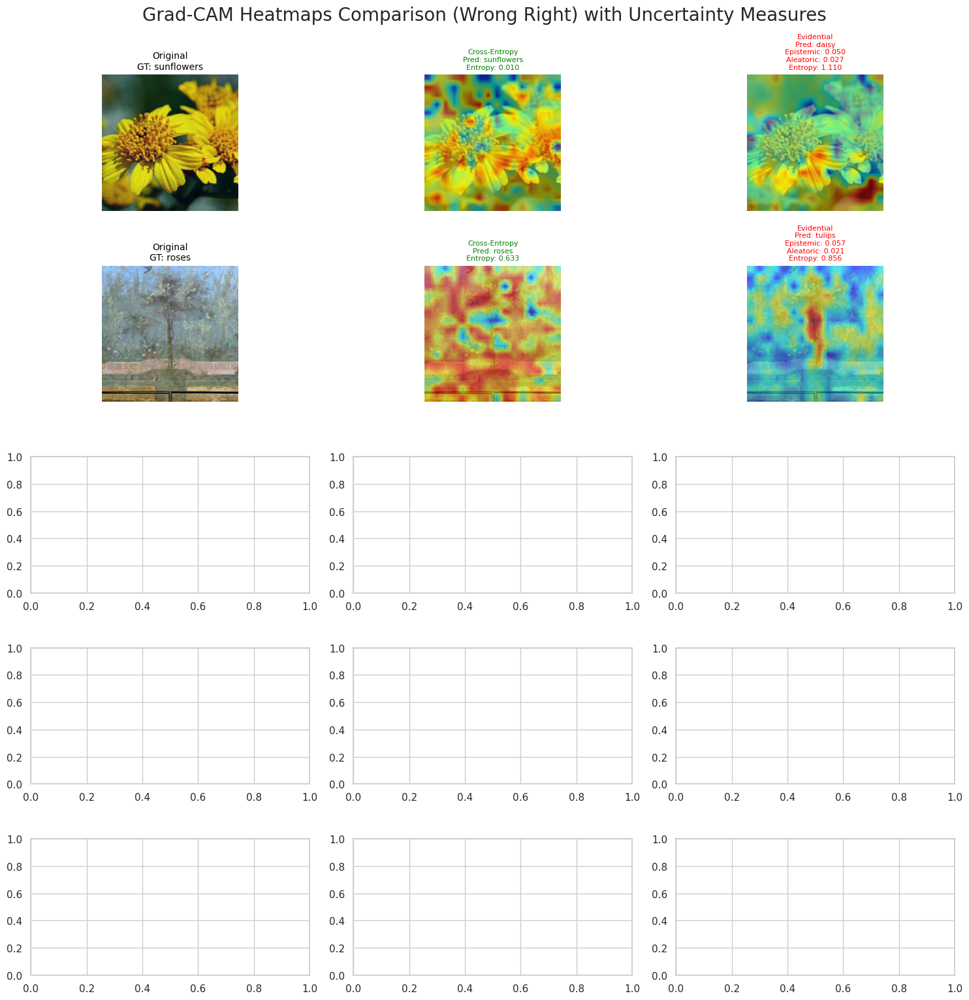

In [48]:
# Compare models
compare_models_heatmaps(
    gradcam_evidential=ev_gradcam,
    gradcam_cross_entropy=ce_gradcam,
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    num_classes=len(test_dataset.classes),  # Dynamically set number of classes
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    condition="wrong_right"  # Options: "right_wrong", "wrong_right", "both_right", "both_wrong"
)

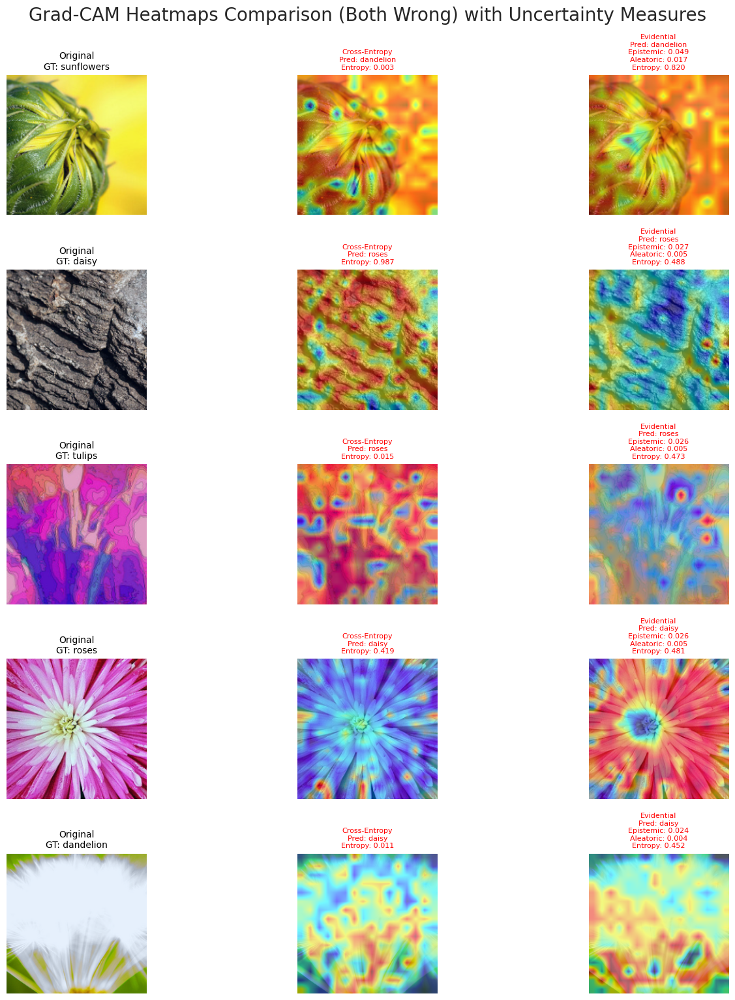

In [49]:
# Compare models
compare_models_heatmaps(
    gradcam_evidential=ev_gradcam,
    gradcam_cross_entropy=ce_gradcam,
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    num_classes=len(test_dataset.classes),  # Dynamically set number of classes
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    condition="both_wrong"  # Options: "right_wrong", "wrong_right", "both_right", "both_wrong"
)

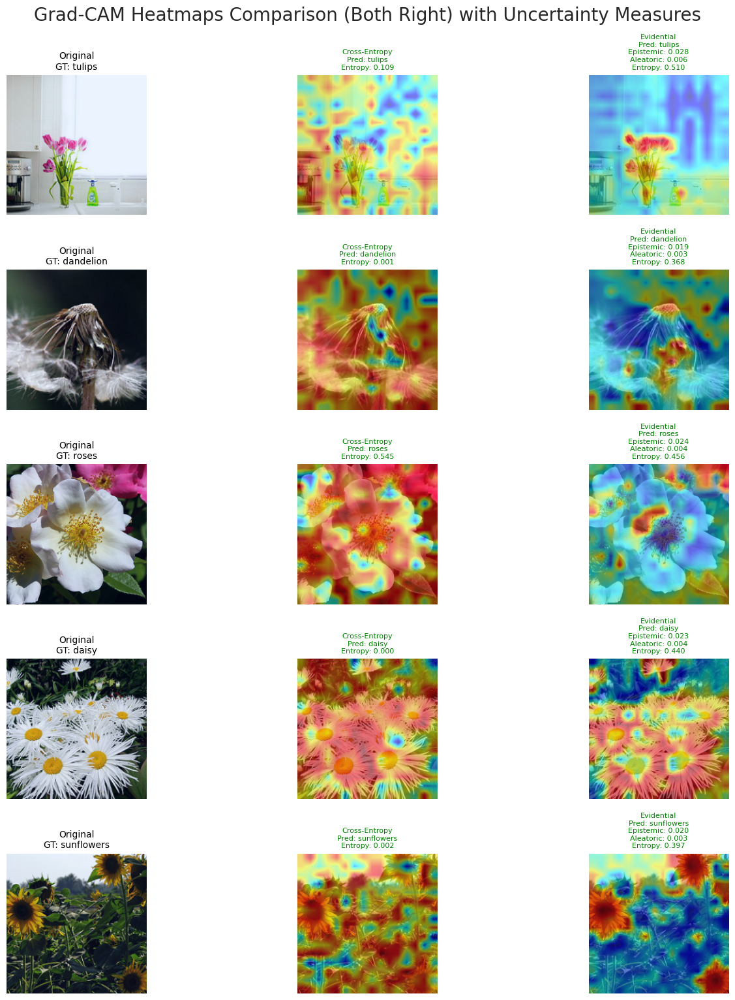

In [55]:
# Compare models
compare_models_heatmaps(
    gradcam_evidential=ev_gradcam,
    gradcam_cross_entropy=ce_gradcam,
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    num_classes=len(test_dataset.classes),  # Dynamically set number of classes
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    condition="both_right"  # Options: "right_wrong", "wrong_right", "both_right", "both_wrong"
)

In [93]:
def plot_top_uncertain_samples(
    test_dataset, model_evidential, model_cross_entropy, 
    device, num_samples=4
):
    """
    Retrieve and plot the top uncertain samples for both models.

    Parameters:
        test_dataset (Dataset): Test dataset to evaluate.
        model_evidential (torch.nn.Module): Evidential model.
        model_cross_entropy (torch.nn.Module): Cross-Entropy model.
        device (torch.device): Device (CPU or GPU).
        num_samples (int): Number of top uncertain samples to retrieve for each model.
    """
    uncertainties = []

    # Loop through the dataset to compute uncertainties
    for idx in range(len(test_dataset)):
        image, label = test_dataset[idx]
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            # Evidential model predictions and uncertainties
            alpha = model_evidential(image)
            evidential_pred = torch.argmax(alpha, dim=1).item()

            # Compute uncertainties for the evidential model
            total_uncertainty, epistemic_uncertainty, aleatoric_uncertainty = calculate_uncertainties(alpha)

            # Cross-Entropy model predictions and entropy
            cross_entropy_output = model_cross_entropy(image)
            cross_entropy_probs = F.softmax(cross_entropy_output, dim=1)
            cross_entropy_pred = torch.argmax(cross_entropy_probs, dim=1).item()

            # Entropy for Cross-Entropy model
            entropy = compute_entropy(cross_entropy_probs)

        uncertainties.append({
            "idx": idx,
            "image": image.squeeze(0),  # Save the image
            "label": label,  # Ground truth label
            "cross_entropy_pred": cross_entropy_pred,
            "cross_entropy_entropy": entropy,
            "evidential_pred": evidential_pred,
            "evidential_total_uncertainty": total_uncertainty,
            "evidential_epistemic_uncertainty": epistemic_uncertainty,
            "evidential_aleatoric_uncertainty": aleatoric_uncertainty
        })

    # Sort by entropy for Cross-Entropy and total uncertainty for Evidential
    top_cross_entropy = sorted(uncertainties, key=lambda x: x["cross_entropy_entropy"], reverse=True)[:num_samples]
    top_evidential = sorted(uncertainties, key=lambda x: x["evidential_total_uncertainty"], reverse=True)[:num_samples]

    # Plot the top uncertain samples for both models
    fig, axes = plt.subplots(2, num_samples, figsize=(20, 10))
    fig.suptitle("Top Uncertain Samples for Cross-Entropy and Evidential Models", fontsize=16)

    for i in range(num_samples):
        # Top Cross-Entropy samples
        sample = top_cross_entropy[i]
        image = sample["image"].permute(1, 2, 0).cpu().numpy()  # Convert to HWC format
        image = (image - image.min()) / (image.max() - image.min())  # Normalize
        axes[0, i].imshow(image)
        axes[0, i].set_title(
            f"GT: {test_dataset.classes[sample['label']]}\n"
            f"Pred: {test_dataset.classes[sample['cross_entropy_pred']]}\n"
            f"Entropy: {sample['cross_entropy_entropy']:.3f}",
            fontsize=10,
            color="red" if sample["label"] != sample["cross_entropy_pred"] else "green"
        )
        axes[0, i].axis("off")

        # Top Evidential samples
        sample = top_evidential[i]
        image = sample["image"].permute(1, 2, 0).cpu().numpy()  # Convert to HWC format
        image = (image - image.min()) / (image.max() - image.min())  # Normalize
        axes[1, i].imshow(image)
        axes[1, i].set_title(
            f"GT: {test_dataset.classes[sample['label']]}\n"
            f"Pred: {test_dataset.classes[sample['evidential_pred']]}\n"
            f"Epistemic: {sample['evidential_epistemic_uncertainty']:.3f}\n"
            f"Aleatoric: {sample['evidential_aleatoric_uncertainty']:.3f}\n"
            f"Entropy: {sample['evidential_total_uncertainty']:.3f}",
            fontsize=10,
            color="red" if sample["label"] != sample["evidential_pred"] else "green"
        )
        axes[1, i].axis("off")

    # Add row titles
    axes[0, 0].set_ylabel("Cross-Entropy", fontsize=14, labelpad=20)
    axes[1, 0].set_ylabel("Evidential", fontsize=14, labelpad=20)

    plt.tight_layout()
    plt.subplots_adjust(top=.95)
    plt.show()


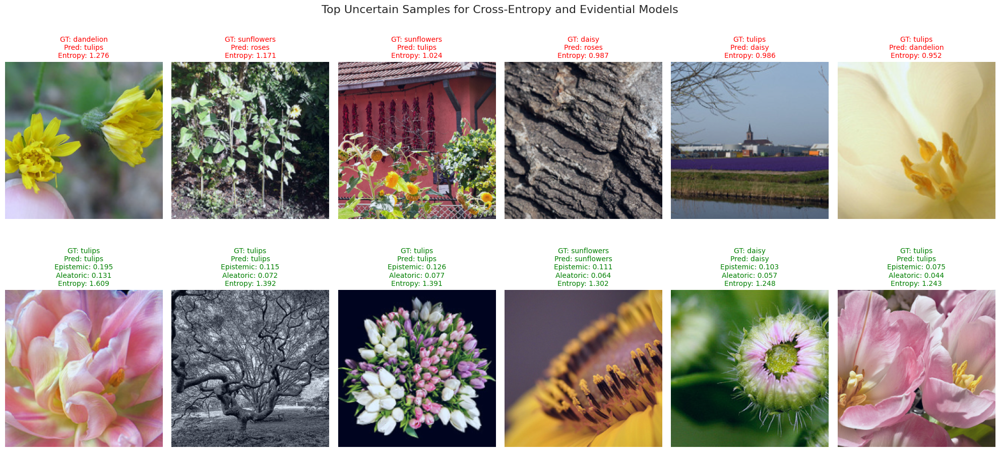

In [94]:
plot_top_uncertain_samples(
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    device=device,
    num_samples=6
)

In [121]:
def scatter_plot_uncertainty_comparison(
    test_dataset, model_evidential, model_cross_entropy, device
):
    """
    Create a 2D scatter plot comparing entropy uncertainties of the evidential and cross-entropy models
    with fixed x and y axis scales.

    Parameters:
        test_dataset (Dataset): Test dataset to evaluate.
        model_evidential (torch.nn.Module): Evidential model.
        model_cross_entropy (torch.nn.Module): Cross-Entropy model.
        device (torch.device): Device (CPU or GPU).
    """
    data = []

    # Loop through the dataset to compute uncertainties and predictions
    for idx in range(len(test_dataset)):
        image, label = test_dataset[idx]
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            # Evidential model predictions and uncertainties
            alpha = model_evidential(image)
            evidential_pred = torch.argmax(alpha, dim=1).item()

            # Compute uncertainties for the evidential model
            total_uncertainty, _, _ = calculate_uncertainties(alpha)

            # Cross-Entropy model predictions and entropy
            cross_entropy_output = model_cross_entropy(image)
            cross_entropy_probs = F.softmax(cross_entropy_output, dim=1)
            cross_entropy_pred = torch.argmax(cross_entropy_probs, dim=1).item()

            # Entropy for Cross-Entropy model
            entropy = compute_entropy(cross_entropy_probs)

        # Determine correctness for each model
        evidential_correct = (evidential_pred == label)
        cross_entropy_correct = (cross_entropy_pred == label)

        # Define the label based on correctness
        if evidential_correct and cross_entropy_correct:
            label = "Both Correct"
            color = "green"
        elif not evidential_correct and not cross_entropy_correct:
            label = "Both Wrong"
            color = "red"
        elif evidential_correct and not cross_entropy_correct:
            label = "Evidential Correct"
            color = "blue"
        elif not evidential_correct and cross_entropy_correct:
            label = "Entropy Correct"
            color = "yellow"

        # Append results
        data.append({
            "Evidential Uncertainty": total_uncertainty,
            "Cross-Entropy Entropy": entropy,
            "Label": label,
            "Color": color
        })

    # Convert data to a DataFrame for Seaborn
    df = pd.DataFrame(data)

    # Create the scatter plot using Seaborn
    sns.set_theme(style="whitegrid")
    plt.figure(figsize=(10, 6))

    # Use Seaborn scatter plot
    sns.scatterplot(
        data=df,
        x="Evidential Uncertainty",
        y="Cross-Entropy Entropy",
        hue="Label",
        palette={"Both Correct": "green", "Both Wrong": "red", "Evidential Correct": "blue", "Entropy Correct": "yellow"},
        s=100,  # Adjust size of points
        alpha=0.6  # Add transparency for better visibility
    )

    # Customize plot
    plt.title("Uncertainty Comparison Between Evidential and Cross-Entropy Models", fontsize=13)
    plt.xlabel("Evidential Model Uncertainity", fontsize=10)
    plt.ylabel("Cross-Entropy Model Uncertainity", fontsize=10)

    # Set fixed axis limits based on the data
    plt.xlim(-0.05, max(df["Evidential Uncertainty"]) * 1.05)  # Extend x-axis slightly beyond the max value
    plt.ylim(-0.05, max(df["Cross-Entropy Entropy"]) * 1.05)  # Extend y-axis slightly beyond the max value

    plt.legend(title="Prediction", loc="upper right", fontsize=10, title_fontsize=11)
    plt.grid(True, linestyle='--', alpha=0.4)

    plt.show()


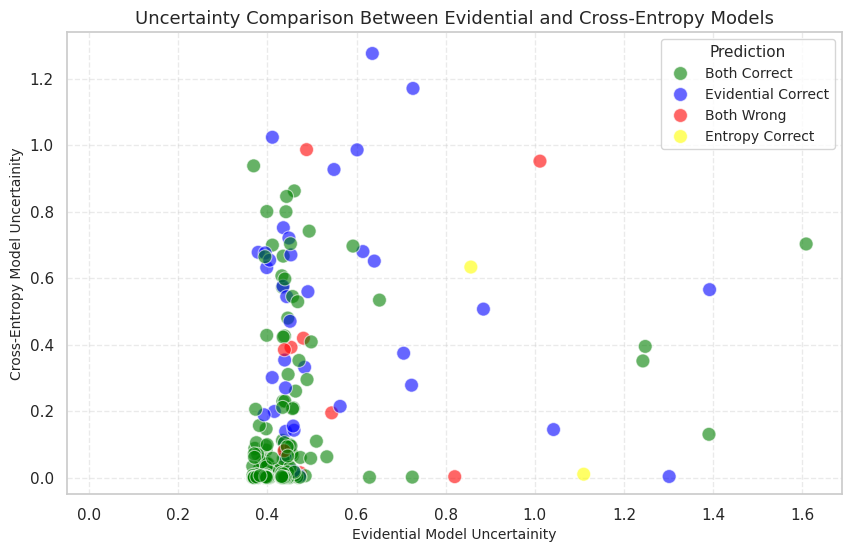

In [122]:
scatter_plot_uncertainty_comparison(
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    device=device
)

In [151]:
def compute_uncertainty_comparison_table(test_dataset, model_evidential, model_cross_entropy, device):
    """
    Compute and display a table comparing the mean uncertainty for correct and incorrect predictions
    between the Evidential and Cross-Entropy models with a professional style.

    Parameters:
        test_dataset (Dataset): Test dataset to evaluate.
        model_evidential (torch.nn.Module): Evidential model.
        model_cross_entropy (torch.nn.Module): Cross-Entropy model.
        device (torch.device): Device (CPU or GPU).
    """
    results = []

    # Loop through the dataset to compute uncertainties and predictions
    for idx in range(len(test_dataset)):
        image, label = test_dataset[idx]
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            # Evidential model predictions and uncertainties
            alpha = model_evidential(image)
            evidential_pred = torch.argmax(alpha, dim=1).item()

            # Compute uncertainties for the evidential model
            total_uncertainty, _, _ = calculate_uncertainties(alpha)

            # Cross-Entropy model predictions and entropy
            cross_entropy_output = model_cross_entropy(image)
            cross_entropy_probs = F.softmax(cross_entropy_output, dim=1)
            cross_entropy_pred = torch.argmax(cross_entropy_probs, dim=1).item()

            # Entropy for Cross-Entropy model
            entropy = compute_entropy(cross_entropy_probs)

        # Determine correctness for each model
        evidential_correct = (evidential_pred == label)
        cross_entropy_correct = (cross_entropy_pred == label)

        # Append results
        results.append({
            "Evidential Uncertainty": total_uncertainty,
            "Cross-Entropy Entropy": entropy,
            "Evidential Correct": evidential_correct,
            "Cross-Entropy Correct": cross_entropy_correct
        })

    # Convert results to a DataFrame for easier analysis
    df = pd.DataFrame(results)

    # Compute mean uncertainty for correct and incorrect predictions
    evidential_correct_mean = df[df["Evidential Correct"]]["Evidential Uncertainty"].mean()
    evidential_wrong_mean = df[~df["Evidential Correct"]]["Evidential Uncertainty"].mean()
    cross_entropy_correct_mean = df[df["Cross-Entropy Correct"]]["Cross-Entropy Entropy"].mean()
    cross_entropy_wrong_mean = df[~df["Cross-Entropy Correct"]]["Cross-Entropy Entropy"].mean()

    # Create a comparison table with rounded float points
    comparison_table = pd.DataFrame({
        "Model": ["Evidential", "Cross-Entropy"],
        "Mean Uncertainty (Correct)": [round(evidential_correct_mean, 3), round(cross_entropy_correct_mean, 3)],
        "Mean Uncertainty (Wrong)": [round(evidential_wrong_mean, 3), round(cross_entropy_wrong_mean, 3)]
    })

    # Display the table using Matplotlib
    fig, ax = plt.subplots(figsize=(10, 4))
    ax.axis("tight")
    ax.axis("off")
    table = ax.table(cellText=comparison_table.values, colLabels=comparison_table.columns, loc="center", cellLoc="center")

    # Style the table
    table.auto_set_font_size(False)
    table.set_fontsize(12)
    table.auto_set_column_width(col=list(range(len(comparison_table.columns))))
    for (row, col), cell in table.get_celld().items():
        if row == 0:  # Header row
            cell.set_text_props(weight="bold", fontsize=10)
            cell.set_facecolor("#f7f7f7")
        cell.set_edgecolor("black")
        cell.set_linewidth(0.2)

    plt.title("Mean Uncertainty Comparison Between Models", fontsize=14, pad=-70)
    plt.show()


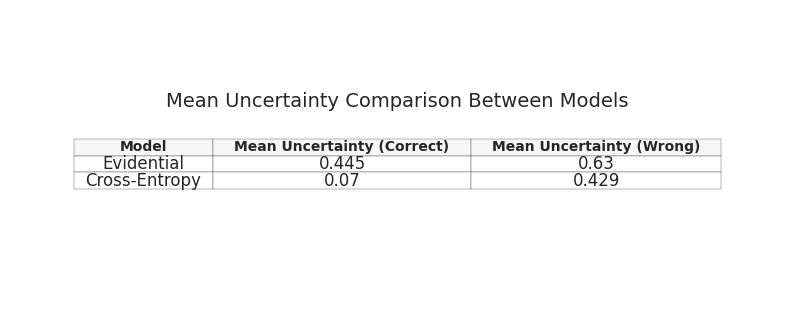

In [152]:
compute_uncertainty_comparison_table(
    test_dataset=test_dataset,
    model_evidential=ev_model,
    model_cross_entropy=ce_model,
    device=device
)